# Your first neural network

In this project, you'll build your first neural network and use it to predict daily bike rental ridership. We've provided some of the code, but left the implementation of the neural network up to you (for the most part). After you've submitted this project, feel free to explore the data and the model more.



In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

## Load and prepare the data

A critical step in working with neural networks is preparing the data correctly. Variables on different scales make it difficult for the network to efficiently learn the correct weights. Below, we've written the code to load and prepare the data. You'll learn more about this soon!

In [2]:
data_path = 'Bike-Sharing-Dataset/hour.csv'

rides = pd.read_csv(data_path)

In [3]:
rides.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


## Checking out the data

This dataset has the number of riders for each hour of each day from January 1 2011 to December 31 2012. The number of riders is split between casual and registered, summed up in the `cnt` column. You can see the first few rows of the data above.

Below is a plot showing the number of bike riders over the first 10 days or so in the data set. (Some days don't have exactly 24 entries in the data set, so it's not exactly 10 days.) You can see the hourly rentals here. This data is pretty complicated! The weekends have lower over all ridership and there are spikes when people are biking to and from work during the week. Looking at the data above, we also have information about temperature, humidity, and windspeed, all of these likely affecting the number of riders. You'll be trying to capture all this with your model.

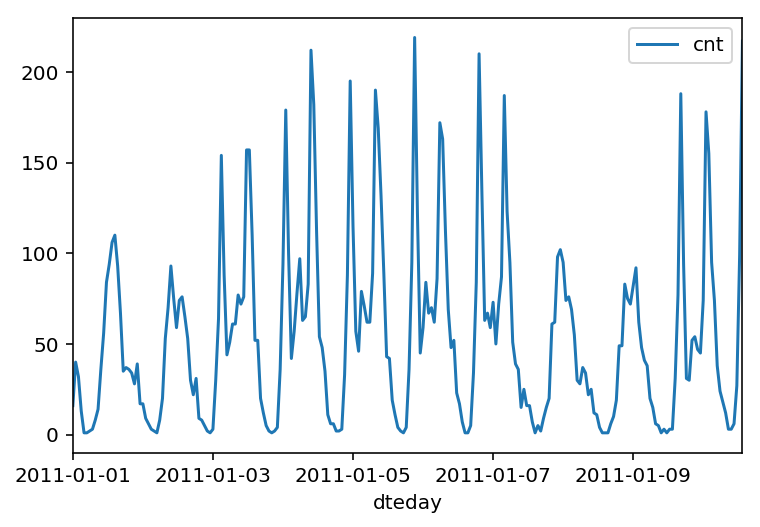

In [4]:
rides[:24*10].plot(x='dteday', y='cnt')

### Dummy variables
Here we have some categorical variables like season, weather, month. To include these in our model, we'll need to make binary dummy variables. This is simple to do with Pandas thanks to `get_dummies()`.

In [5]:
dummy_fields = ['season', 'weathersit', 'mnth', 'hr', 'weekday']
for each in dummy_fields:
    dummies = pd.get_dummies(rides[each], prefix=each, drop_first=False)
    rides = pd.concat([rides, dummies], axis=1)

fields_to_drop = ['instant', 'dteday', 'season', 'weathersit', 
                  'weekday', 'atemp', 'mnth', 'workingday', 'hr']
data = rides.drop(fields_to_drop, axis=1)
data.head()

,yr,holiday,temp,hum,windspeed,casual,registered,cnt,season_1,season_2,...,hr_21,hr_22,hr_23,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6
0,0,0,0.24,0.81,0.0,3,13,16,1,0,...,0,0,0,0,0,0,0,0,0,1
1,0,0,0.22,0.80,0.0,8,32,40,1,0,...,0,0,0,0,0,0,0,0,0,1
2,0,0,0.22,0.80,0.0,5,27,32,1,0,...,0,0,0,0,0,0,0,0,0,1
3,0,0,0.24,0.75,0.0,3,10,13,1,0,...,0,0,0,0,0,0,0,0,0,1
4,0,0,0.24,0.75,0.0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,1


### Scaling target variables
To make training the network easier, we'll standardize each of the continuous variables. That is, we'll shift and scale the variables such that they have zero mean and a standard deviation of 1.

The scaling factors are saved so we can go backwards when we use the network for predictions.

In [6]:
quant_features = ['casual', 'registered', 'cnt', 'temp', 'hum', 'windspeed']
# Store scalings in a dictionary so we can convert back later
scaled_features = {}
for each in quant_features:
    mean, std = data[each].mean(), data[each].std()
    scaled_features[each] = [mean, std]
    data.loc[:, each] = (data[each] - mean)/std

### Splitting the data into training, testing, and validation sets

We'll save the data for the last approximately 21 days to use as a test set after we've trained the network. We'll use this set to make predictions and compare them with the actual number of riders.

In [7]:
# Save data for approximately the last 21 days 
test_data = data[-21*24:]

# Now remove the test data from the data set 
data = data[:-21*24]

# Separate the data into features and targets
target_fields = ['cnt', 'casual', 'registered']
features, targets = data.drop(target_fields, axis=1), data[target_fields]
test_features, test_targets = test_data.drop(target_fields, axis=1), test_data[target_fields]

We'll split the data into two sets, one for training and one for validating as the network is being trained. Since this is time series data, we'll train on historical data, then try to predict on future data (the validation set).

In [8]:
# Hold out the last 60 days or so of the remaining data as a validation set
train_features, train_targets = features[:-60*24], targets[:-60*24]
val_features, val_targets = features[-60*24:], targets[-60*24:]

## Time to build the network

Below you'll build your network. We've built out the structure. You'll implement both the forward pass and backwards pass through the network. You'll also set the hyperparameters: the learning rate, the number of hidden units, and the number of training passes.

<img src="assets/neural_network.png" width=300px>

The network has two layers, a hidden layer and an output layer. The hidden layer will use the sigmoid function for activations. The output layer has only one node and is used for the regression, the output of the node is the same as the input of the node. That is, the activation function is $f(x)=x$. A function that takes the input signal and generates an output signal, but takes into account the threshold, is called an activation function. We work through each layer of our network calculating the outputs for each neuron. All of the outputs from one layer become inputs to the neurons on the next layer. This process is called *forward propagation*.

We use the weights to propagate signals forward from the input to the output layers in a neural network. We use the weights to also propagate error backwards from the output back into the network to update our weights. This is called *backpropagation*.

> **Hint:** You'll need the derivative of the output activation function ($f(x) = x$) for the backpropagation implementation. If you aren't familiar with calculus, this function is equivalent to the equation $y = x$. What is the slope of that equation? That is the derivative of $f(x)$.

Below, you have these tasks:
1. Implement the sigmoid function to use as the activation function. Set `self.activation_function` in `__init__` to your sigmoid function.
2. Implement the forward pass in the `train` method.
3. Implement the backpropagation algorithm in the `train` method, including calculating the output error.
4. Implement the forward pass in the `run` method.
  

In [9]:
#############
# In the my_answers.py file, fill out the TODO sections as specified
#############

from my_answers import NeuralNetwork

In [10]:
def MSE(y, Y):
    return np.mean((y-Y)**2)

## Unit tests

Run these unit tests to check the correctness of your network implementation. This will help you be sure your network was implemented correctly befor you starting trying to train it. These tests must all be successful to pass the project.

In [11]:
import unittest

inputs = np.array([[0.5, -0.2, 0.1]])
targets = np.array([[0.4]])
test_w_i_h = np.array([[0.1, -0.2],
                       [0.4, 0.5],
                       [-0.3, 0.2]])
test_w_h_o = np.array([[0.3],
                       [-0.1]])

class TestMethods(unittest.TestCase):
    
    ##########
    # Unit tests for data loading
    ##########
    
    def test_data_path(self):
        # Test that file path to dataset has been unaltered
        self.assertTrue(data_path.lower() == 'bike-sharing-dataset/hour.csv')
        
    def test_data_loaded(self):
        # Test that data frame loaded
        self.assertTrue(isinstance(rides, pd.DataFrame))
    
    ##########
    # Unit tests for network functionality
    ##########

    def test_activation(self):
        network = NeuralNetwork(3, 2, 1, 0.5)
        # Test that the activation function is a sigmoid
        self.assertTrue(np.all(network.activation_function(0.5) == 1/(1+np.exp(-0.5))))

    def test_train(self):
        # Test that weights are updated correctly on training
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()
        
        network.train(inputs, targets)
        
        self.assertTrue(np.allclose(network.weights_hidden_to_output, 
                                    np.array([[ 0.37275328], 
                                              [-0.03172939]])))
        self.assertTrue(np.allclose(network.weights_input_to_hidden,
                                    np.array([[ 0.10562014, -0.20185996], 
                                              [0.39775194, 0.50074398], 
                                              [-0.29887597, 0.19962801]])))

    def test_run(self):
        # Test correctness of run method
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()

        self.assertTrue(np.allclose(network.run(inputs), 0.09998924))

suite = unittest.TestLoader().loadTestsFromModule(TestMethods())
unittest.TextTestRunner().run(suite)

.....

forward: X [ 0.5 -0.2  0.1]



----------------------------------------------------------------------
Ran 5 tests in 0.014s

OK


<unittest.runner.TextTestResult run=5 errors=0 failures=0>

## Training the network

Here you'll set the hyperparameters for the network. The strategy here is to find hyperparameters such that the error on the training set is low, but you're not overfitting to the data. If you train the network too long or have too many hidden nodes, it can become overly specific to the training set and will fail to generalize to the validation set. That is, the loss on the validation set will start increasing as the training set loss drops.

You'll also be using a method know as Stochastic Gradient Descent (SGD) to train the network. The idea is that for each training pass, you grab a random sample of the data instead of using the whole data set. You use many more training passes than with normal gradient descent, but each pass is much faster. This ends up training the network more efficiently. You'll learn more about SGD later.

### Choose the number of iterations
This is the number of batches of samples from the training data we'll use to train the network. The more iterations you use, the better the model will fit the data. However, this process can have sharply diminishing returns and can waste computational resources if you use too many iterations.  You want to find a number here where the network has a low training loss, and the validation loss is at a minimum. The ideal number of iterations would be a level that stops shortly after the validation loss is no longer decreasing.

### Choose the learning rate
This scales the size of weight updates. If this is too big, the weights tend to explode and the network fails to fit the data. Normally a good choice to start at is 0.1; however, if you effectively divide the learning rate by n_records, try starting out with a learning rate of 1. In either case, if the network has problems fitting the data, try reducing the learning rate. Note that the lower the learning rate, the smaller the steps are in the weight updates and the longer it takes for the neural network to converge.

### Choose the number of hidden nodes
In a model where all the weights are optimized, the more hidden nodes you have, the more accurate the predictions of the model will be.  (A fully optimized model could have weights of zero, after all.) However, the more hidden nodes you have, the harder it will be to optimize the weights of the model, and the more likely it will be that suboptimal weights will lead to overfitting. With overfitting, the model will memorize the training data instead of learning the true pattern, and won't generalize well to unseen data.  

Try a few different numbers and see how it affects the performance. You can look at the losses dictionary for a metric of the network performance. If the number of hidden units is too low, then the model won't have enough space to learn and if it is too high there are too many options for the direction that the learning can take. The trick here is to find the right balance in number of hidden units you choose.  You'll generally find that the best number of hidden nodes to use ends up being between the number of input and output nodes.

In [12]:
import sys

####################
### Set the hyperparameters in you myanswers.py file ###
####################

from my_answers import iterations, learning_rate, hidden_nodes, output_nodes


N_i = train_features.shape[1]
network = NeuralNetwork(N_i, hidden_nodes, output_nodes, learning_rate)

losses = {'train':[], 'validation':[]}
for ii in range(iterations):
    # Go through a random batch of 128 records from the training data set
    batch = np.random.choice(train_features.index, size=128)
    X, y = train_features.ix[batch].values, train_targets.ix[batch]['cnt']
                             
    network.train(X, y)
    
    # Printing out the training progress
    train_loss = MSE(network.run(train_features).T, train_targets['cnt'].values)
    val_loss = MSE(network.run(val_features).T, val_targets['cnt'].values)
    sys.stdout.write("\rProgress: {:2.1f}".format(100 * ii/float(iterations)) \
                     + "% ... Training loss: " + str(train_loss)[:5] \
                     + " ... Validation loss: " + str(val_loss)[:5])
    sys.stdout.flush()
    
    losses['train'].append(train_loss)
    losses['validation'].append(val_loss)

/Users/scrier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


forward: X [ 0.          0.          0.53497563  1.62116534 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.64620666  0.32535746  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          1.36590221 -0.24479801 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.33460919 -0.5557919   2.47181485  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          1.        ]
forward: X [0.         0.         1.15817056 0.84368061 0.03189788 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          0.63884145  1.05100987 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.   

Progress: 0.0% ... Training loss: 0.983 ... Validation loss: 1.314forward: X [ 1.          0.         -0.81528007 -0.29663033  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.11951233  1.93215924 -0.82146002  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

forward: X [ 1.          0.          1.26203639 -1.33327663 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.19208513  1.31017145  0.88607317  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.4311098  -0.86678579  1.86203995  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          1.         -0.08821931 -1.54060589  0.27629827  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.32724398  0.27352514 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398 -1.33327663  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 0.4% ... Training loss: 0.964 ... Validation loss: 1.293forward: X [ 0.          0.         -0.9191459   1.25833914 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.5036826   0.99917756  0.51988127  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

Progress: 0.6% ... Training loss: 0.943 ... Validation loss: 1.302forward: X [ 0.          0.          0.53497563 -0.34846264 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         1.05430474 0.1180282  0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.   

Progress: 0.8% ... Training loss: 0.935 ... Validation loss: 1.376forward: X [ 0.          0.          0.22337816  1.62116534 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425  0.42902209 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1. 

forward: X [ 1.          0.         -0.71141425  1.56933303  2.10644035  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.9191459  -0.71128885  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 1.0% ... Training loss: 0.925 ... Validation loss: 1.290forward: X [ 1.          0.          0.4311098   0.27352514 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [1.         0.         0.74270727 0.1180282  0.03189788 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.   

forward: X [ 0.          0.          0.74270727 -0.65945653  1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.11951233 1.62116534 0.51988127 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0

Progress: 1.2% ... Training loss: 0.935 ... Validation loss: 1.257forward: X [ 1.          0.          1.15817056  0.16986051 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731  -0.45212727 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0. 

forward: X [ 0.          0.          0.53497563  1.05100987 -1.55384381  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.22337816 -2.73274915  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 1.4% ... Training loss: 0.900 ... Validation loss: 1.291forward: X [ 0.          0.         -0.39981678  0.42902209 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  0.48085441 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0. 

Progress: 1.6% ... Training loss: 0.891 ... Validation loss: 1.307forward: X [ 0.          0.          0.74270727 -0.81495348  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425 -1.02228274  0.51988127  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0. 

  0.          0.        ]
forward: X [ 0.          0.          1.26203639 -0.91861811  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.9191459  -1.64427052  2.71621524  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

 0.         0.        ]
forward: X [ 0.          0.         -0.81528007 -1.229612   -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.39981678 -0.03746875  0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.  

Progress: 1.8% ... Training loss: 0.886 ... Validation loss: 1.330forward: X [ 0.          0.         -1.43847501 -0.14113338  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.01564651 -1.229612    0.03189788  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

  1.          0.        ]
forward: X [ 0.          0.         -0.19208513  1.62116534  0.27629827  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.67749968 -1.69610284 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 1.          0.          1.36590221 -1.74793515  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          1.46976803 -0.86678579  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.43847501  0.06619588 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.46976803 -0.40029496  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 2.0% ... Training loss: 0.877 ... Validation loss: 1.327forward: X [ 0.          0.         -1.12687754 -0.5557919   0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [1.         0.         1.15817056 0.37718977 0.76428167 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.   

forward: X [ 1.          0.         -1.43847501 -1.43694126  0.88607317  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          1.          0.63884145 -0.08930106  1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 2.2% ... Training loss: 0.870 ... Validation loss: 1.272forward: X [ 0.          0.         -0.5036826   1.25833914  0.03189788  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.39981678  0.42902209  0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0. 

forward: X [ 1.          0.          0.01564651 -0.19296569 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [0.         0.         0.11951233 0.74001598 0.51988127 0.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0

forward: X [ 1.          0.          1.05430474  1.10284219 -1.55384381  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [1.         0.         0.22337816 0.53268672 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0

Progress: 2.4% ... Training loss: 0.879 ... Validation loss: 1.381forward: X [ 0.          0.          0.4311098  -0.34846264  1.13047356  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.39981678  0.99917756  0.03189788  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

forward: X [ 0.          0.          0.8465731   0.7918483  -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336  0.1180282   0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.01564651 -1.48877358  1.61845695  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [0.         0.         0.4311098  1.62116534 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0

Progress: 2.6% ... Training loss: 0.868 ... Validation loss: 1.225forward: X [ 0.          0.          0.22337816 -2.26625831  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.08821931  0.99917756 -0.82146002  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

  0.          0.        ]
forward: X [ 1.          0.          1.05430474 -1.33327663 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -1.43847501  0.63635135  1.13047356  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -0.29595096 -0.97045042  1.13047356  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398 -0.5557919   0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 2.8% ... Training loss: 0.847 ... Validation loss: 1.324forward: X [ 1.          0.         -0.71141425  0.68818367 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   1.25833914 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0. 

Progress: 3.0% ... Training loss: 0.839 ... Validation loss: 1.231forward: X [ 0.          0.         -1.23074336  0.63635135 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [0.         0.         0.74270727 0.53268672 0.27629827 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.   

forward: X [ 0.          0.          0.74270727  1.36200377 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
Progress: 3.2% ... Training loss: 0.824 ... Validation loss: 1.244forward: X [ 0.          0.         -1.43847501  0.89551293 -0.21168512  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

 0.         0.        ]
forward: X [0.         0.         1.15817056 0.84368061 0.76428167 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 1.          0.          0.74270727 -0.81495348  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.     

Progress: 3.4% ... Training loss: 0.822 ... Validation loss: 1.318forward: X [ 1.          0.         -0.39981678 -0.81495348  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.46976803 -0.19296569 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0. 

forward: X [ 0.          0.          1.15817056 -1.48877358  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.74270727  0.7918483  -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [1.         0.         1.46976803 0.37718977 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 0.          0.          1.26203639 -1.07411506  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 3.6% ... Training loss: 0.809 ... Validation loss: 1.241forward: X [0.         0.         0.8465731  1.05100987 1.13047356 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.        ]
forward: X [ 0.          0.         -1.54234083  0.32535746 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.    

Progress: 3.8% ... Training loss: 0.821 ... Validation loss: 1.353forward: X [ 0.          0.         -1.23074336 -1.54060589 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.7813655  -0.34846264 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0. 

  0.          0.        ]
forward: X [ 0.          0.         -0.29595096  0.99917756  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.71141425 -1.17777969  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.

  0.          1.        ]
forward: X [ 1.          0.          0.63884145 -1.02228274  0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563  0.53268672 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 1.          0.          0.4311098  -0.14113338 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          0.53497563  0.7918483  -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 4.2% ... Training loss: 0.801 ... Validation loss: 1.311forward: X [0.         0.         1.36590221 0.16986051 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.         -0.5036826   0.99917756 -0.82146002  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.    

Progress: 4.4% ... Training loss: 0.790 ... Validation loss: 1.285forward: X [0.         0.         1.05430474 0.58451904 0.76428167 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 1.          0.         -0.29595096  1.62116534 -0.45608552  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.    

Progress: 4.6% ... Training loss: 0.787 ... Validation loss: 1.195forward: X [ 0.          0.         -1.23074336 -0.14113338  0.27629827  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425 -0.50395959 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0. 

  0.          1.        ]
forward: X [ 0.          0.         -0.71141425  0.68818367  0.27629827  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.02301172  1.93215924 -0.82146002  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 4.8% ... Training loss: 0.794 ... Validation loss: 1.337forward: X [ 0.          0.         -1.02301172 -1.9034321   2.95979824  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          2.19682879 -1.07411506  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

forward: X [ 0.          0.          1.15817056  0.84368061 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          1.36590221 -0.76312116  1.86203995  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.8465731   1.36200377 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.60754843  0.68818367  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 5.0% ... Training loss: 0.772 ... Validation loss: 1.207forward: X [ 0.          0.         -0.81528007  1.25833914  0.27629827  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  1.05100987 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1. 

forward: X [ 1.          0.         -1.23074336 -0.14113338  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          2.19682879 -1.17777969  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 5.2% ... Training loss: 0.771 ... Validation loss: 1.283forward: X [ 1.          0.          0.11951233 -0.76312116  2.71621524  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [0.         0.         0.53497563 1.05100987 0.51988127 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.   

forward: X [ 0.          0.         -0.9191459  -0.08930106  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          0.22337816  0.74001598 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [0.         0.         0.22337816 1.31017145 0.51988127 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [1.         0.         0.8465731  1.05100987 0.03189788 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.       

forward: X [ 0.          0.          0.53497563  1.31017145 -0.82146002  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.29595096 -1.54060589  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 5.4% ... Training loss: 0.765 ... Validation loss: 1.179forward: X [0.         0.         0.74270727 1.05100987 0.03189788 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.         -0.9191459   1.56933303 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.    

forward: X [0.         0.         0.63884145 0.1180282  0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 1.          0.          0.8465731  -0.81495348  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.     

forward: X [ 0.          0.          1.15817056  0.16986051 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.15817056 -0.03746875  2.71621524  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 1.          0.          1.67749968 -0.71128885  2.47181485  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.8465731   1.62116534 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.

Progress: 5.8% ... Training loss: 0.743 ... Validation loss: 1.214forward: X [1.         0.         0.22337816 0.27352514 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          0.22337816 -0.5557919   0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.    

Progress: 6.0% ... Training loss: 0.743 ... Validation loss: 1.266forward: X [ 0.          0.         -0.39981678  0.22169283  1.13047356  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.19208513  0.48085441  0.27629827  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0. 

  0.          1.        ]
forward: X [ 0.          0.         -0.19208513 -0.60762422 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563 -1.17777969  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.          0.95043892  0.84368061 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.11951233 1.05100987 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 6.2% ... Training loss: 0.733 ... Validation loss: 1.212forward: X [ 0.          0.          0.8465731  -0.29663033 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.36590221 -0.40029496  0.51988127  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0. 

forward: X [ 0.          0.         -0.5036826   0.99917756  0.51988127  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.57363386 -1.12594737  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 6.4% ... Training loss: 0.872 ... Validation loss: 1.100forward: X [ 0.          0.         -1.75007248  0.32535746  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.57363386 -2.00709673 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0. 

forward: X [ 0.          0.          1.88523132 -0.65945653  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.01564651  0.27352514 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 6.6% ... Training loss: 0.727 ... Validation loss: 1.263forward: X [0.         0.         0.8465731  0.7918483  2.10644035 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 0.          0.         -0.81528007 -2.26625831  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.    

forward: X [ 0.          0.          0.74270727  0.32535746 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425  0.68818367 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 6.8% ... Training loss: 0.717 ... Validation loss: 1.233forward: X [ 0.          0.         -1.43847501  1.56933303  1.37405656  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425  0.68818367  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0. 

forward: X [ 0.          0.          1.05430474  0.84368061 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          1.         -0.71141425  0.42902209 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 7.0% ... Training loss: 0.714 ... Validation loss: 1.154forward: X [ 0.          0.         -1.43847501 -0.40029496  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.43847501  0.89551293 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0. 

forward: X [ 1.          0.         -1.64620666  0.32535746  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.63884145 0.32535746 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 0.          0.          0.32724398  1.93215924 -0.69966852  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -1.54234083  0.89551293  0.51988127  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.19208513  1.93215924  0.27629827  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.54234083 -0.60762422  0.27629827  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 7.2% ... Training loss: 0.724 ... Validation loss: 1.297forward: X [1.         0.         1.15817056 0.37718977 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 1.          0.          0.32724398 -1.43694126  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.    

forward: X [ 1.          0.          0.32724398 -1.02228274 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          1.26203639  0.37718977 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.01564651 -1.85159979  1.61845695  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.22337816 1.62116534 0.51988127 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 0.          0.          1.36590221 -0.76312116  0.03189788  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.36590221 -0.76312116  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 7.4% ... Training loss: 0.719 ... Validation loss: 1.110forward: X [ 1.          0.          1.88523132 -0.65945653 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.23074336  1.93215924 -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

  0.          0.        ]
forward: X [ 0.          0.          0.63884145 -1.74793515  1.61845695  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.53497563 -1.02228274 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   0.99917756 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007  0.94734524 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 7.6% ... Training loss: 0.698 ... Validation loss: 1.204forward: X [ 0.          0.         -1.02301172 -0.08930106 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.12687754 -0.08930106  0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0. 

forward: X [ 0.          0.          1.57363386 -0.40029496  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.01564651 -1.07411506  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.          0.53497563  0.7918483  -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.53497563 -0.14113338  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.

Progress: 7.8% ... Training loss: 0.694 ... Validation loss: 1.170forward: X [ 0.          0.         -1.12687754 -0.5557919  -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.63884145 -1.12594737  1.61845695  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0. 

forward: X [ 0.          0.         -0.29595096  1.31017145 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -2.06166995 -0.86678579 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 8.0% ... Training loss: 0.693 ... Validation loss: 1.207forward: X [ 1.          0.         -0.39981678  0.22169283  1.61845695  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398 -1.33327663  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

Progress: 8.2% ... Training loss: 0.716 ... Validation loss: 1.084forward: X [ 0.          0.         -1.12687754  1.25833914 -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826  -1.43694126 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

Progress: 8.4% ... Training loss: 0.687 ... Validation loss: 1.199forward: X [ 1.          0.         -0.9191459   0.94734524  0.03189788  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336 -1.28144432  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

forward: X [ 0.          0.          0.74270727  1.36200377 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425  0.94734524 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 8.6% ... Training loss: 0.683 ... Validation loss: 1.126forward: X [ 0.          0.          0.32724398  1.31017145 -0.21168512  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.22337816 -0.14113338  0.27629827  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0. 

forward: X [ 0.          0.          1.15817056 -1.95526442  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.63884145  1.62116534 -0.69966852  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -1.02301172  1.93215924 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336  1.56933303  1.13047356  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 8.8% ... Training loss: 0.688 ... Validation loss: 1.240forward: X [ 0.          0.         -1.54234083 -1.59243821  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.43847501  0.89551293 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0. 

forward: X [ 0.          0.         -0.81528007  0.16986051  1.61845695  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145 -1.12594737 -0.21168512  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          1.          0.63884145  1.62116534 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
Progress: 9.0% ... Training loss: 0.685 ... Validation loss: 1.093forward: X [ 1.          0.          0.22337816 -1.9034321   2.10644035  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

forward: X [ 0.          0.         -0.60754843 -0.86678579 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          1.7813655  -0.50395959  1.13047356  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 9.2% ... Training loss: 0.671 ... Validation loss: 1.132forward: X [ 0.          0.         -0.08821931  0.99917756  0.03189788  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [1.         0.         0.53497563 0.32535746 0.51988127 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.   

forward: X [0.         0.         0.32724398 1.31017145 0.03189788 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          0.32724398  0.27352514 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.     

Progress: 9.4% ... Training loss: 0.670 ... Validation loss: 1.115forward: X [ 1.          0.          0.22337816 -0.34846264 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.39981678 -1.59243821  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

  0.          0.        ]
forward: X [1.         0.         0.63884145 0.32535746 1.13047356 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.         -1.8539383  -1.07411506  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.   

Progress: 9.6% ... Training loss: 0.663 ... Validation loss: 1.150forward: X [ 0.          0.          0.74270727  1.36200377 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.71141425 -0.50395959 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

Progress: 9.8% ... Training loss: 0.665 ... Validation loss: 1.188forward: X [ 1.          0.          0.74270727  0.53268672 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.02301172 -1.229612    0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0. 

Progress: 10.0% ... Training loss: 0.659 ... Validation loss: 1.113forward: X [ 1.          0.         -0.81528007  1.25833914  1.37405656  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.39981678  0.74001598  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.60754843 -1.17777969 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.22337816  1.31017145 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

Progress: 10.2% ... Training loss: 0.669 ... Validation loss: 1.219forward: X [ 0.          0.          0.22337816  0.74001598 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.53497563 -0.71128885 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

forward: X [0.         0.         1.15817056 0.42902209 0.88607317 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 0.          0.          1.15817056 -0.91861811  0.51988127  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 10.4% ... Training loss: 0.655 ... Validation loss: 1.109forward: X [ 0.          0.         -1.75007248 -0.81495348 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.8539383   1.20650682 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [1.         0.         0.22337816 0.06619588 1.13047356 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 1.          0.          0.11951233 -0.76312116 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

 0.         0.        ]
forward: X [ 0.          0.          0.74270727 -0.50395959 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.11951233  1.93215924 -0.82146002  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.  

forward: X [ 0.          0.         -1.54234083  0.32535746 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.39981678  0.22169283 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.  

forward: X [ 1.          0.          1.46976803 -0.5557919   0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -0.60754843  0.99917756  1.13047356  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 10.8% ... Training loss: 0.652 ... Validation loss: 1.163forward: X [ 0.          0.         -0.19208513  0.74001598  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          2.09296297 -1.54060589  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -1.23074336  0.1180282  -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425  0.42902209 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 11.0% ... Training loss: 0.673 ... Validation loss: 1.037forward: X [ 0.          0.          0.95043892  1.05100987 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.57363386 -0.40029496  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.19208513  1.62116534 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.02301172 -1.229612   -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          1.46976803 -1.28144432  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.75007248 -1.17777969  2.22823185  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

 0.         0.        ]
forward: X [ 1.          0.         -0.19208513  0.01436357 -0.45608552  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.9191459   1.25833914 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.  

forward: X [ 0.          1.         -1.75007248  0.89551293  0.03189788  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.46976803 -0.19296569 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [0.         0.         0.01564651 0.48085441 2.22823185 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
Progress: 11.4% ... Training loss: 0.662 ... Validation loss: 1.041forward: X [ 1.          0.         -0.81528007  0.68818367 -1.55384381  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.         -1.23074336  0.1180282  -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.05430474  0.84368061 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.75007248  0.06619588 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.75007248 -0.19296569  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 11.6% ... Training loss: 0.653 ... Validation loss: 1.046forward: X [ 1.          0.         -1.8539383  -0.45212727 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          2.19682879 -2.42175525 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.11951233 -0.5557919  -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.9191459  -0.50395959  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.11951233 -0.19296569  0.03189788  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [0.         0.         0.32724398 0.53268672 1.86203995 0.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0

forward: X [ 1.          0.          0.53497563 -0.71128885  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.43847501 -0.40029496 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.74270727  0.1180282  -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [0.         0.         1.05430474 0.84368061 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 0.          0.         -1.23074336 -1.28144432  0.27629827  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.4311098   0.27352514 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 12.0% ... Training loss: 0.641 ... Validation loss: 1.160forward: X [ 0.          0.         -1.75007248 -0.19296569 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.01564651 -0.60762422  1.61845695  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -2.47713324 -0.97045042 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.02301172  1.25833914  0.27629827  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          1.26203639 -1.17777969  1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          1.7813655  -1.229612   -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 12.2% ... Training loss: 0.659 ... Validation loss: 1.232forward: X [ 0.          0.         -0.39981678 -0.24479801  0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -1.33460919  0.37718977 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -1.12687754  0.63635135 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.22337816  0.06619588 -0.82146002  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  1.          0.        ]
forward: X [ 1.          0.          0.95043892 -0.81495348  2.47181485  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.54234083 -1.17777969 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 12.4% ... Training loss: 0.635 ... Validation loss: 1.126forward: X [ 0.          0.          0.22337816  1.62116534 -0.45608552  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          1.26203639  0.16986051 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.8465731  -0.65945653 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -0.39981678  1.62116534  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.8465731  -0.65945653 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          1.          0.8465731   1.62116534 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

Progress: 12.6% ... Training loss: 0.632 ... Validation loss: 1.106forward: X [ 1.          0.          1.05430474 -0.76312116  0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.33460919  0.1180282  -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

forward: X [ 0.          0.         -1.54234083  0.32535746 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.54234083 -0.19296569 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.  

Progress: 12.8% ... Training loss: 0.649 ... Validation loss: 1.206forward: X [ 0.          0.          1.26203639 -0.60762422  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.08821931 -1.229612    1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  1.          0.        ]
forward: X [ 0.          0.         -0.29595096  1.93215924  0.03189788  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [1.         0.         0.95043892 0.84368061 0.51988127 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1

forward: X [ 1.          0.          1.05430474 -0.24479801 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  0.53268672 -0.69966852  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 13.0% ... Training loss: 0.632 ... Validation loss: 1.127forward: X [ 1.          0.         -0.39981678 -1.12594737  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          1.36590221 -1.54060589 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          1.        ]
forward: X [0.         0.         0.53497563 1.93215924 0.03189788 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 0.          0.          0.74270727  1.36200377 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.   

forward: X [ 0.          0.         -0.71141425  0.68818367  0.03189788  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.8465731   0.32535746 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  1.31017145 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          1.05430474 -0.24479801  2.10644035  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 13.2% ... Training loss: 0.629 ... Validation loss: 1.107forward: X [ 0.          0.         -0.5036826  -0.65945653  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.57363386 -1.74793515 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.71141425 -0.50395959 -0.45608552  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.26203639  0.37718977 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          1.57363386 -1.12594737 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -1.23074336  0.37718977 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          1.57363386 -0.86678579  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.63884145 -1.02228274 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.          1.98909715 -0.81495348 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.8465731  -1.48877358  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 1.          0.          1.15817056 -0.60762422 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.74270727  0.1180282  -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.         -0.9191459   0.37718977  0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.22337816  0.27352514 -0.45608552  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -0.08821931  0.74001598  2.71621524  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.9191459  -0.29663033  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

forward: X [1.         0.         0.01564651 0.74001598 1.37405656 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 0.          0.          1.26203639 -0.76312116  2.71621524  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 0.          0.          0.53497563  0.06619588 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.4311098   0.7918483  -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.74270727 -0.50395959  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.53497563 -1.43694126  0.88607317  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 13.8% ... Training loss: 0.627 ... Validation loss: 1.123forward: X [0.         0.         1.15817056 0.58451904 0.27629827 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.          1.26203639 -0.24479801  2.22823185  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 1.          0.          0.32724398  1.31017145 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.22337816 1.31017145 0.76428167 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 0.          0.          1.15817056 -0.76312116 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.15817056 -0.24479801  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 14.0% ... Training loss: 0.629 ... Validation loss: 1.042forward: X [ 0.          0.          1.26203639  0.16986051 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.33460919  1.56933303  0.51988127  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [0.         0.         0.32724398 0.53268672 0.88607317 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [1.         0.         0.74270727 0.32535746 1.61845695 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.       

  1.          0.        ]
forward: X [ 0.          0.         -1.12687754  0.63635135 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826  -0.24479801  0.03189788  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.

Progress: 14.2% ... Training loss: 0.622 ... Validation loss: 1.081forward: X [ 1.          0.         -1.12687754 -0.91861811  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.74270727 0.7918483  0.03189788 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 0.          0.          0.74270727  0.7918483  -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.53497563  1.93215924 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [0.         1.         0.53497563 1.31017145 3.20419864 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.          1.88523132 -1.12594737  1.13047356  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.   

Progress: 14.6% ... Training loss: 0.620 ... Validation loss: 1.062forward: X [ 0.          0.         -2.37326742 -0.91861811  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474  0.84368061 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.          0.32724398 -0.34846264  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.95043892  0.1180282  -0.82146002  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.

Progress: 14.8% ... Training loss: 0.619 ... Validation loss: 1.057forward: X [ 1.          0.          0.53497563  0.7918483  -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425 -0.03746875 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.

forward: X [ 0.          0.          1.15817056 -0.60762422 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [0.         0.         0.53497563 0.7918483  0.51988127 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 0.          0.          0.8465731  -0.08930106  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.22337816  0.53268672 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.  

forward: X [ 1.          0.         -1.8539383  -1.02228274  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          1.         -1.95780412 -0.45212727 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.         -0.81528007  0.16986051 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.63884145  1.05100987 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 15.2% ... Training loss: 0.619 ... Validation loss: 1.033forward: X [ 1.          0.         -0.29595096  1.62116534 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563  0.7918483  -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [1.         0.         1.36590221 0.16986051 0.76428167 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.          0.95043892  0.58451904 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 15.4% ... Training loss: 0.620 ... Validation loss: 1.021forward: X [ 1.          0.          1.98909715 -1.59243821  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [0.         0.         0.22337816 1.31017145 0.03189788 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.  

forward: X [ 0.          0.         -0.9191459   1.25833914  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474 -0.60762422 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          1.         -0.71141425  0.42902209 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007 -1.95526442 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          1.88523132 -0.65945653 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.36590221 -0.03746875 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 15.6% ... Training loss: 0.617 ... Validation loss: 1.024forward: X [ 0.          0.         -0.5036826   1.25833914  1.37405656  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.95043892 -1.9034321   0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.81528007  1.25833914  0.51988127  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.74270727  0.1180282  -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.01564651 -1.85159979  1.61845695  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731   1.62116534 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

Progress: 15.8% ... Training loss: 0.613 ... Validation loss: 1.032forward: X [ 0.          0.         -0.39981678  0.99917756  0.88607317  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          1.05430474  0.84368061 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.08821931 -0.19296569  0.88607317  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [1.         0.         1.36590221 0.16986051 0.27629827 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 1.          0.          1.15817056  0.37718977 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398 -0.5557919  -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 16.0% ... Training loss: 0.613 ... Validation loss: 1.023forward: X [ 1.          0.          1.15817056 -1.229612   -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          1.         -1.33460919 -1.43694126 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.5036826  -0.03746875  2.71621524  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -1.23074336 -0.14113338  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 16.2% ... Training loss: 0.626 ... Validation loss: 1.158forward: X [ 1.          0.          0.95043892  1.36200377 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425  0.42902209  0.76428167  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [0.         0.         1.26203639 0.37718977 0.76428167 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [0.         0.         0.74270727 0.53268672 0.76428167 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.       

forward: X [ 0.          0.         -0.81528007 -1.07411506  0.88607317  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.01564651 -0.91861811  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 16.4% ... Training loss: 0.609 ... Validation loss: 1.080forward: X [ 1.          0.          0.8465731   1.62116534 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.57363386 -0.5557919   1.13047356  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [0.         0.         0.32724398 0.06619588 0.88607317 0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [1.         0.         0.53497563 1.31017145 0.51988127 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.       

  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  0.74001598  1.13047356  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425 -0.29663033 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.

Progress: 16.6% ... Training loss: 0.606 ... Validation loss: 1.061forward: X [ 1.          0.         -1.02301172 -0.5557919  -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.26203639  0.37718977 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          1.         -0.60754843  0.68818367  0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.95043892 1.36200377 0.03189788 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0

Progress: 16.8% ... Training loss: 0.623 ... Validation loss: 0.979forward: X [ 0.          0.         -0.81528007 -1.74793515 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.33460919  0.1180282   0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.29595096  1.93215924  1.13047356  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.95043892  0.84368061 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.71141425  0.68818367  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.67749968 -0.5557919  -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 17.0% ... Training loss: 0.605 ... Validation loss: 1.076forward: X [ 0.          0.         -2.16553577  0.53268672 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.11951233  1.10284219 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -2.47713324 -0.76312116 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.22337816 1.62116534 0.76428167 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [1.         0.         1.15817056 0.37718977 0.03189788 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.         -1.12687754 -0.08930106  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

 0.         0.        ]
forward: X [ 0.          0.         -1.33460919 -0.76312116  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.74270727 1.62116534 0.27629827 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

forward: X [ 1.          0.          0.74270727  0.32535746 -1.55384381  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007 -0.86678579  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [0.         0.         0.22337816 0.27352514 0.27629827 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.        ]
forward: X [ 1.          0.         -0.19208513  1.31017145 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 1.          0.          1.05430474 -0.60762422 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.11951233 -0.19296569  0.03189788  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.9191459  -0.29663033  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.11951233 -1.85159979  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 17.4% ... Training loss: 0.603 ... Validation loss: 1.016forward: X [ 0.          0.         -1.43847501  1.56933303 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.67749968 -0.5557919   0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -1.02301172  1.93215924 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -1.33460919  0.37718977  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.

forward: X [ 0.          0.         -0.60754843  0.68818367  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233  1.93215924 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 17.6% ... Training loss: 0.607 ... Validation loss: 0.991forward: X [ 0.          0.         -1.12687754 -1.38510895 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -0.39981678 -1.43694126  1.61845695  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          1.26203639  0.84368061 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -1.54234083 -1.74793515 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 17.8% ... Training loss: 0.622 ... Validation loss: 1.158forward: X [ 0.          0.          1.67749968 -0.86678579 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.8539383  -0.65945653  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          1.        ]
forward: X [ 1.          0.          0.53497563  0.53268672 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.26203639 -1.17777969 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 18.0% ... Training loss: 0.598 ... Validation loss: 1.052forward: X [ 0.          0.         -1.54234083 -0.40029496  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [0.         0.         0.74270727 1.36200377 2.95979824 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

 0.         0.        ]
forward: X [ 1.          0.         -0.39981678  0.42902209 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.43847501 -0.40029496  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.  

Progress: 18.2% ... Training loss: 0.596 ... Validation loss: 1.035forward: X [ 0.          0.         -1.33460919 -0.76312116 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.29595096  0.22169283 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.02301172  0.63635135 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          1.          0.74270727  1.05100987 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

Progress: 18.4% ... Training loss: 0.597 ... Validation loss: 1.001forward: X [ 1.          0.         -0.29595096 -1.69610284  2.10644035  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425  0.94734524 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.11951233 -2.83641378  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          0.74270727 -1.28144432  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 18.6% ... Training loss: 0.593 ... Validation loss: 1.034forward: X [ 1.          0.          0.01564651 -1.74793515  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.4311098   1.31017145 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.8539383  -1.54060589  2.22823185  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   1.25833914  0.27629827  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 18.8% ... Training loss: 0.600 ... Validation loss: 1.083forward: X [ 0.          0.         -1.8539383   1.56933303 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.67749968 -0.86678579 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.5036826  -0.24479801 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          1.26203639 -0.60762422  1.13047356  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 19.0% ... Training loss: 0.591 ... Validation loss: 1.015forward: X [ 0.          0.         -1.95780412 -0.45212727  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   0.16986051 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.29595096 -0.45212727 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.05430474  0.1180282  -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 19.2% ... Training loss: 0.627 ... Validation loss: 0.933forward: X [ 0.          0.         -0.60754843  1.25833914  0.76428167  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [0.         0.         0.95043892 1.05100987 0.76428167 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

  0.          0.        ]
forward: X [ 0.          0.          0.53497563 -1.17777969  1.13047356  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.43847501  1.56933303  1.13047356  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 19.4% ... Training loss: 0.624 ... Validation loss: 0.931forward: X [ 1.          0.         -0.29595096 -0.03746875  0.03189788  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474  1.10284219 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.

forward: X [ 1.          0.          0.63884145 -1.43694126  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.29595096 -0.45212727  0.27629827  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

Progress: 19.6% ... Training loss: 0.590 ... Validation loss: 1.045forward: X [1.         0.         0.8465731  0.32535746 0.27629827 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 0.          0.         -1.43847501 -0.60762422 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.         -0.19208513  1.93215924  0.27629827  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.26203639 -0.91861811 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 19.8% ... Training loss: 0.587 ... Validation loss: 1.025forward: X [ 0.          0.         -0.29595096  1.62116534  0.76428167  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.54234083 -1.33327663  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.01564651 -1.07411506 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425 -0.03746875 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.81528007 -2.26625831  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.11951233 -1.17777969  1.13047356  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 20.0% ... Training loss: 0.588 ... Validation loss: 1.041forward: X [ 0.          0.          1.15817056 -1.33327663 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          1.26203639 -0.24479801  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [0.         0.         0.4311098  1.31017145 0.03189788 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 0.          0.         -1.43847501 -1.43694126  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

  0.          0.        ]
forward: X [ 1.          0.         -0.5036826   0.42902209 -0.45608552  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.36590221 -0.40029496  2.71621524  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 20.2% ... Training loss: 0.612 ... Validation loss: 1.129forward: X [ 1.          0.          1.57363386 -0.40029496  2.10644035  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731   1.36200377 -1.55384381  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.8465731   0.32535746 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.75007248  0.89551293 -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 20.4% ... Training loss: 0.601 ... Validation loss: 1.097forward: X [0.         0.         0.01564651 0.48085441 0.03189788 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.          1.15817056 -0.45212727  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.   

forward: X [ 0.          0.          0.8465731  -1.38510895 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.08821931  0.01436357 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.         -1.02301172  0.37718977 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007 -0.50395959  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.

Progress: 20.8% ... Training loss: 0.584 ... Validation loss: 0.966forward: X [ 0.          0.          0.74270727 -0.08930106 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          1.          1.67749968 -1.12594737 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 21.0% ... Training loss: 0.631 ... Validation loss: 0.910forward: X [ 0.          0.          1.15817056  0.16986051 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.19208513  0.22169283  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.8465731   0.58451904 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.29595096 -0.97045042  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

Progress: 21.2% ... Training loss: 0.596 ... Validation loss: 1.083forward: X [ 1.          0.         -0.81528007  0.42902209  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.54234083 -0.19296569 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          1.36590221 -0.40029496  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [0.         0.         0.63884145 1.62116534 0.51988127 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 21.4% ... Training loss: 0.610 ... Validation loss: 0.915forward: X [ 1.          0.          0.8465731  -0.45212727  0.88607317  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -0.5036826  -1.17777969  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 21.6% ... Training loss: 0.584 ... Validation loss: 0.937forward: X [ 0.          0.         -0.9191459  -0.08930106  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          1.57363386 -0.40029496 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

Progress: 21.8% ... Training loss: 0.586 ... Validation loss: 1.052forward: X [ 0.          0.         -0.60754843  0.99917756 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [1.         0.         0.95043892 0.1180282  0.88607317 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 0.          0.         -0.19208513  0.22169283  0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.22337816 -0.5557919   1.37405656  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 22.0% ... Training loss: 0.582 ... Validation loss: 0.932forward: X [1.         0.         1.26203639 0.16986051 0.51988127 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 1.          0.          0.53497563 -1.17777969 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.          0.22337816 -0.14113338  0.76428167  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.63884145 1.93215924 0.51988127 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0

 0.         1.        ]
forward: X [ 1.          0.          0.63884145 -1.43694126  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474 -0.24479801  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.  

forward: X [ 0.          0.         -1.12687754 -2.00709673  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.81528007 -0.71128885 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

forward: X [ 0.          0.         -0.9191459  -0.71128885 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.9191459  -1.07411506 -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [0.         0.         0.74270727 0.53268672 0.51988127 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.          0.53497563  1.31017145 -0.82146002  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 1.          0.          0.53497563  0.32535746 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [0.         0.         0.8465731  1.05100987 0.51988127 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 22.4% ... Training loss: 0.594 ... Validation loss: 1.081forward: X [ 0.          0.         -0.39981678  0.22169283  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.32724398 -1.9034321   2.47181485  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.5036826  -1.43694126  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.8539383   0.01436357 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

Progress: 22.6% ... Training loss: 0.570 ... Validation loss: 0.967forward: X [ 1.          0.         -1.02301172  0.37718977 -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.63884145 -1.12594737 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.          0.63884145 -1.12594737  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.32724398 1.05100987 0.51988127 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1

Progress: 22.8% ... Training loss: 0.572 ... Validation loss: 1.003forward: X [ 1.          0.          0.22337816  1.31017145 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.81528007 -0.86678579  2.71621524  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          1.          1.57363386 -1.54060589  2.22823185  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.26203639 -0.24479801 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 23.0% ... Training loss: 0.568 ... Validation loss: 0.963forward: X [ 0.          0.         -0.60754843  0.16986051 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.74270727  0.7918483  -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

Progress: 23.2% ... Training loss: 0.569 ... Validation loss: 0.991forward: X [ 1.          0.         -0.39981678  1.93215924  0.88607317  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474  0.37718977 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

 0.         0.        ]
forward: X [ 1.          0.         -0.5036826  -1.33327663  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.15817056  0.84368061 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.  

Progress: 23.4% ... Training loss: 0.567 ... Validation loss: 0.943forward: X [ 1.          0.          0.63884145 -1.28144432  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.36590221 -0.40029496 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.

forward: X [ 0.          0.         -1.23074336 -1.43694126 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [1.         0.         0.63884145 1.31017145 1.37405656 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 23.6% ... Training loss: 0.588 ... Validation loss: 1.062forward: X [ 0.          0.         -0.08821931 -0.76312116 -0.45608552  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.64620666 -1.17777969  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          1.57363386 -1.02228274  0.03189788  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.74270727 -0.65945653 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 23.8% ... Training loss: 0.578 ... Validation loss: 0.909forward: X [ 0.          0.         -1.54234083 -0.97045042  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.54234083 -1.17777969  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -1.33460919  0.63635135 -0.82146002  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425  0.16986051 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.95043892 -1.38510895  1.13047356  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [1.         0.         0.8465731  1.05100987 3.20419864 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0

Progress: 24.2% ... Training loss: 0.564 ... Validation loss: 0.924forward: X [ 1.          0.          1.57363386 -1.64427052 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [0.         0.         0.22337816 1.31017145 1.61845695 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 1.          0.          1.57363386 -0.40029496 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.53497563  0.7918483  -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.  

forward: X [0.         0.         0.11951233 1.62116534 0.27629827 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          1.05430474  0.37718977 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.     

Progress: 24.4% ... Training loss: 0.559 ... Validation loss: 0.952forward: X [ 1.          0.         -0.5036826  -1.17777969  2.10644035  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          1.          1.15817056  0.37718977 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.8465731   0.58451904 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.43847501  0.89551293 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.19208513 -0.97045042 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.26203639  0.16986051 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

Progress: 24.6% ... Training loss: 0.578 ... Validation loss: 0.894forward: X [ 0.          0.          1.36590221 -0.24479801  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  1.31017145 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.9191459   0.94734524 -0.69966852  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [0.         0.         0.74270727 0.32535746 0.27629827 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [1.         0.         0.22337816 0.74001598 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.         -1.43847501  1.56933303 -0.69966852  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.     

  1.          0.        ]
forward: X [ 0.          0.          1.36590221 -0.24479801  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [1.         0.         0.74270727 0.32535746 0.76428167 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

forward: X [ 1.          0.          0.74270727 -0.08930106  0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.36590221 -1.64427052  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 25.0% ... Training loss: 0.566 ... Validation loss: 0.998forward: X [0.         0.         0.22337816 1.31017145 0.76428167 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          0.01564651 -0.60762422 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.         -1.02301172  0.63635135  0.51988127  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [1.         0.         0.63884145 0.1180282  1.13047356 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1

Progress: 25.2% ... Training loss: 0.555 ... Validation loss: 0.943forward: X [ 0.          0.         -0.39981678  0.99917756  1.86203995  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398 -0.14113338  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [1.         0.         0.53497563 1.05100987 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 1.          0.         -0.08821931 -0.76312116 -0.21168512  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 25.4% ... Training loss: 0.560 ... Validation loss: 0.980forward: X [ 0.          0.         -0.29595096 -1.12594737  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          1.          2.19682879 -1.43694126  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -1.23074336  0.1180282   0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.74270727  1.36200377 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 25.6% ... Training loss: 0.552 ... Validation loss: 0.930forward: X [ 0.          0.          0.53497563  1.62116534 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.39981678  0.74001598  0.88607317  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [1.         0.         1.57363386 0.16986051 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 0.          0.          0.8465731   0.58451904 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [1.         0.         0.53497563 1.62116534 0.03189788 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          1.05430474 -2.00709673  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 25.8% ... Training loss: 0.574 ... Validation loss: 1.024forward: X [ 0.          0.         -0.29595096 -1.54060589  0.88607317  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         0.01564651 1.62116534 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [0.         0.         0.32724398 1.62116534 0.27629827 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.        ]
forward: X [ 1.          0.          0.22337816 -0.34846264 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 26.0% ... Training loss: 0.553 ... Validation loss: 0.962forward: X [ 1.          0.          0.95043892 -0.08930106 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         1.26203639 0.37718977 0.76428167 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 0.          0.          0.32724398  1.31017145 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.64620666 -1.74793515  2.10644035  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 26.2% ... Training loss: 0.557 ... Validation loss: 0.892forward: X [ 0.          0.          0.32724398  1.62116534 -1.55384381  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.26203639 -0.76312116  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          1.        ]
forward: X [ 0.          0.         -0.71141425  0.42902209 -0.45608552  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.88523132 -1.12594737  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -0.39981678 -0.03746875  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [0.         0.         0.63884145 0.32535746 0.27629827 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1

Progress: 26.4% ... Training loss: 0.552 ... Validation loss: 0.897forward: X [ 1.          0.         -0.71141425 -0.65945653  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -1.43847501  0.06619588 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.          0.63884145 -0.65945653  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  1.05100987 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -0.08821931  1.31017145  0.03189788  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  0.99917756  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

Progress: 26.6% ... Training loss: 0.547 ... Validation loss: 0.936forward: X [ 1.          0.          0.8465731  -1.38510895 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.9191459  -0.29663033  0.76428167  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.

forward: X [ 1.          1.          1.15817056  0.58451904 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.12687754 -0.91861811 -0.21168512  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.          0.8465731   0.32535746 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.15817056 -0.24479801  0.27629827  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 26.8% ... Training loss: 0.548 ... Validation loss: 0.947forward: X [ 1.          0.          0.11951233  1.05100987 -0.21168512  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.4311098  0.7918483  0.03189788 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.  

  0.          0.        ]
forward: X [ 0.          0.          0.53497563  1.93215924 -1.55384381  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.95043892  0.84368061 -1.55384381  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -1.33460919  0.63635135  0.88607317  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.01564651  1.31017145 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

Progress: 27.0% ... Training loss: 0.545 ... Validation loss: 0.905forward: X [ 0.          0.         -0.9191459   0.16986051 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398 -0.5557919   0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.54234083 -1.59243821  2.47181485  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          2.30069462 -1.64427052 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 27.2% ... Training loss: 0.551 ... Validation loss: 0.965forward: X [ 1.          0.         -0.29595096 -0.60762422  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.64620666 -1.74793515  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          1.67749968 -0.71128885  1.61845695  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.9191459  -0.29663033  0.76428167  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 27.4% ... Training loss: 0.544 ... Validation loss: 0.892forward: X [ 0.          0.         -0.29595096 -2.5772522   1.61845695  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.98909715 -1.79976747  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.63884145 -1.02228274  3.69218203  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -1.43847501 -0.40029496  0.03189788  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 1.          0.         -0.39981678 -1.28144432  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.33460919 -1.12594737 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 27.6% ... Training loss: 0.542 ... Validation loss: 0.898forward: X [ 0.          0.         -0.5036826  -1.69610284  1.86203995  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731   0.32535746 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.

forward: X [ 0.          0.          0.32724398  1.05100987 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.32724398 -0.5557919   0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 27.8% ... Training loss: 0.540 ... Validation loss: 0.896forward: X [ 0.          0.          0.32724398  0.01436357 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.33460919 -0.97045042  0.27629827  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          1.

  0.          0.        ]
forward: X [ 0.          0.         -1.75007248  1.56933303 -0.69966852  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.43847501 -0.14113338 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.

Progress: 28.0% ... Training loss: 0.569 ... Validation loss: 0.860forward: X [ 0.          0.         -0.29595096 -0.03746875  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.74270727  0.7918483  -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.01564651 -0.19296569 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336  0.37718977 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 28.2% ... Training loss: 0.578 ... Validation loss: 1.031forward: X [0.         0.         0.53497563 0.7918483  0.51988127 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 0.          0.         -0.9191459  -2.11076136  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

  0.          0.        ]
forward: X [ 1.          0.          0.01564651  0.74001598 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.95043892  0.1180282  -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 28.4% ... Training loss: 0.535 ... Validation loss: 0.907forward: X [ 0.          0.          1.7813655  -0.19296569  0.03189788  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   0.42902209 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  0.01436357 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425 -0.65945653  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.

Progress: 28.6% ... Training loss: 0.535 ... Validation loss: 0.916forward: X [ 0.          0.          1.05430474  0.1180282  -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          0.11951233  0.74001598 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.

  0.          1.        ]
forward: X [ 0.          0.          0.74270727 -1.12594737  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.39981678  0.42902209 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -0.81528007 -0.50395959  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.36590221 -0.40029496 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.33460919  1.25833914 -0.21168512  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007  0.42902209  1.61845695  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.         -1.43847501 -0.40029496  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007  0.94734524 -0.82146002  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 29.2% ... Training loss: 0.535 ... Validation loss: 0.872forward: X [ 1.          0.         -0.9191459   0.16986051 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [1.         0.         1.15817056 0.16986051 0.76428167 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

Progress: 29.4% ... Training loss: 0.538 ... Validation loss: 0.939forward: X [ 0.          0.         -0.9191459  -0.29663033 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.54234083 -0.40029496  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 29.6% ... Training loss: 0.530 ... Validation loss: 0.875forward: X [ 1.          0.          0.4311098  -0.34846264 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.67749968 -0.34846264  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.8465731  -0.97045042  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.36590221 -0.03746875  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -1.54234083 -0.81495348  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233 -0.5557919   1.13047356  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  1.          0.        ]
forward: X [ 1.          0.          0.95043892  1.36200377 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          2.19682879 -1.17777969  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -0.60754843 -0.45212727 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.23074336  0.37718977  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.23074336  0.63635135 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.81528007  1.25833914  0.27629827  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.5036826   0.1180282   0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.57363386 -0.86678579  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          1.46976803 -0.86678579  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.39981678 -2.26625831  3.44778164  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.32724398 -0.71128885  1.86203995  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.02301172 -1.07411506 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 30.6% ... Training loss: 0.522 ... Validation loss: 0.877forward: X [ 0.          0.         -0.81528007  1.25833914  0.88607317  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.33460919 -0.14113338 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.

  0.          0.        ]
forward: X [ 1.          0.          1.67749968 -0.5557919  -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474  0.84368061 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 30.8% ... Training loss: 0.526 ... Validation loss: 0.902forward: X [0.         0.         0.22337816 1.62116534 1.61845695 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          1.46976803 -0.40029496 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [1.         0.         0.63884145 0.32535746 0.76428167 0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.          0.63884145  0.53268672 -0.69966852  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 0.          0.          1.15817056  0.37718977 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.32724398  1.93215924 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

Progress: 31.0% ... Training loss: 0.539 ... Validation loss: 0.840forward: X [ 1.          0.         -1.02301172 -0.91861811  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425  0.68818367  0.03189788  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [1.         0.         0.53497563 1.62116534 2.22823185 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.         -0.08821931 -1.54060589  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 31.2% ... Training loss: 0.519 ... Validation loss: 0.880forward: X [1.         0.         0.8465731  1.05100987 3.20419864 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.         -0.71141425  0.94734524  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.         -1.23074336  0.1180282  -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          1.05430474  0.58451904 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 31.4% ... Training loss: 0.517 ... Validation loss: 0.863forward: X [ 1.          0.         -0.29595096  1.62116534 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145 -1.02228274  0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.

  1.          0.        ]
forward: X [ 1.          0.         -1.23074336 -0.97045042  1.13047356  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   0.68818367 -0.21168512  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -0.29595096  1.93215924  0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  1.31017145 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [1.         0.         0.32724398 1.05100987 0.76428167 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.         -1.02301172 -0.71128885  0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 1.          1.          0.8465731   1.36200377 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.95043892 1.05100987 0.27629827 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   0.42902209  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         0.4311098  1.05100987 0.27629827 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

Progress: 31.8% ... Training loss: 0.514 ... Validation loss: 0.863forward: X [ 0.          0.          0.63884145 -0.50395959 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.33460919 -0.14113338  2.22823185  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

forward: X [ 1.          0.         -1.33460919  1.25833914 -0.21168512  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -2.06166995 -0.71128885  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.  

forward: X [ 1.          0.         -0.39981678  1.31017145 -0.21168512  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.64620666  0.58451904 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

forward: X [ 0.          0.         -2.37326742 -0.29663033 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.57363386 -0.5557919  -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -1.43847501  0.63635135 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.60754843  1.25833914 -0.82146002  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.          1.7813655  -0.71128885  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          1.26203639 -1.33327663 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 1.          0.          1.15817056  0.37718977 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -1.54234083 -1.85159979  2.22823185  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

Progress: 32.0% ... Training loss: 0.513 ... Validation loss: 0.852forward: X [0.         0.         1.15817056 0.58451904 0.76428167 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [1.         0.         0.4311098  1.31017145 0.76428167 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0

  0.          0.        ]
forward: X [ 0.          0.         -0.60754843  1.25833914 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.12687754 -1.12594737 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [0.         0.         1.05430474 0.1180282  0.03189788 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          1.          0.01564651 -1.64427052  0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

  1.          0.        ]
forward: X [ 0.          0.          0.01564651  1.31017145 -0.21168512  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.39981678  1.62116534  1.37405656  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.

forward: X [ 0.          0.         -1.43847501 -0.81495348  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [0.         0.         0.8465731  1.36200377 0.88607317 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 32.2% ... Training loss: 0.514 ... Validation loss: 0.843forward: X [ 0.          1.         -0.81528007 -0.08930106 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233 -0.40029496 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.5036826   0.99917756 -0.82146002  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.43847501 -0.81495348 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          1.46976803 -0.19296569  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.8465731   1.05100987 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

  0.          0.        ]
forward: X [ 1.          0.          1.67749968 -0.34846264  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.63884145  0.32535746 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 32.4% ... Training loss: 0.514 ... Validation loss: 0.837forward: X [ 1.          0.         -0.08821931 -1.64427052  3.20419864  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398  1.31017145 -0.45608552  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.

  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   0.99917756 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.11951233 1.62116534 0.88607317 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0

 0.         0.        ]
forward: X [ 0.          0.         -0.5036826  -0.03746875  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.12687754 -0.91861811 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.  

forward: X [ 0.          0.          0.53497563  1.31017145 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.95043892  0.58451904 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 32.6% ... Training loss: 0.517 ... Validation loss: 0.889forward: X [ 1.          0.         -1.02301172  0.94734524  0.76428167  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563  0.53268672 -0.21168512  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.         -0.08821931 -1.64427052  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398 -1.02228274  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -0.29595096  1.93215924 -1.55384381  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.26203639  0.58451904 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [1.         0.         0.53497563 1.31017145 0.76428167 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 1.          0.         -0.9191459  -1.64427052 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.     

forward: X [ 1.          0.         -1.33460919 -1.12594737  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.53497563 -0.34846264  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 32.8% ... Training loss: 0.548 ... Validation loss: 0.955forward: X [0.         0.         0.74270727 1.36200377 0.03189788 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          0.22337816 -0.71128885 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

  0.          0.        ]
forward: X [ 0.          0.         -1.54234083  0.63635135 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.22337816 1.31017145 2.10644035 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1

forward: X [ 1.          0.          0.11951233  1.05100987 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.46976803 -1.95526442  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.5036826   1.25833914 -1.55384381  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.02301172  0.37718977  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 33.0% ... Training loss: 0.512 ... Validation loss: 0.876forward: X [ 1.          0.          0.22337816  1.05100987 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -0.81528007 -1.64427052  2.47181485  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  1.          0.        ]
forward: X [ 0.          0.         -0.5036826  -1.17777969  0.27629827  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.67749968 -1.48877358  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 33.2% ... Training loss: 0.507 ... Validation loss: 0.854forward: X [ 0.          0.         -1.75007248  1.56933303 -1.55384381  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.33460919  0.1180282  -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

forward: X [ 0.          0.          0.11951233 -1.07411506 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.54234083  0.32535746 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

  1.          0.        ]
forward: X [ 1.          1.          0.63884145 -0.08930106  1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.4311098  -1.02228274  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 33.4% ... Training loss: 0.508 ... Validation loss: 0.866forward: X [ 0.          0.         -1.54234083  0.89551293 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.39981678 -1.9034321  -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.5036826  -0.03746875  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.63884145 -0.29663033  1.86203995  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [1.         0.         0.22337816 0.74001598 0.27629827 0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.          1.26203639 -1.33327663 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.     

Progress: 33.6% ... Training loss: 0.523 ... Validation loss: 0.905forward: X [ 0.          0.          1.88523132 -1.48877358  0.03189788  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.63884145  1.05100987 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.9191459  -0.50395959  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          1.          1.36590221 -0.91861811  1.13047356  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.         -1.33460919 -0.34846264 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.8539383   1.20650682 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -1.23074336 -0.76312116 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -1.54234083  0.89551293  0.03189788  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 1.          0.         -1.54234083  0.89551293  0.51988127  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.23074336 -0.14113338 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 34.0% ... Training loss: 0.502 ... Validation loss: 0.846forward: X [ 1.          0.          0.11951233  0.74001598 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.43847501  0.06619588 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.74270727  0.53268672 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.19208513 -0.19296569 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -1.43847501 -1.12594737  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.63884145  0.7918483  -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

Progress: 34.2% ... Training loss: 0.502 ... Validation loss: 0.826forward: X [ 1.          0.          1.7813655  -0.81495348  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -1.12687754 -0.08930106 -0.82146002  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

forward: X [ 0.          0.         -1.64620666 -0.60762422 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.32724398  1.62116534 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

 0.         1.        ]
forward: X [0.         0.         0.01564651 1.31017145 2.22823185 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 1.          0.          1.67749968 -1.28144432  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.     

Progress: 34.4% ... Training loss: 0.510 ... Validation loss: 0.875forward: X [ 0.          0.          0.8465731  -0.65945653 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.22337816 1.31017145 1.61845695 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.  

  1.          0.        ]
forward: X [ 1.          0.          0.11951233 -0.40029496  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.8539383  -0.65945653  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 34.6% ... Training loss: 0.498 ... Validation loss: 0.836forward: X [ 0.          0.         -1.23074336 -0.34846264 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.15817056  0.37718977 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.33460919  1.25833914 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.9191459   0.68818367  1.13047356  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 34.8% ... Training loss: 0.507 ... Validation loss: 0.814forward: X [ 1.          0.          1.05430474 -0.76312116  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.39981678  0.74001598  0.88607317  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  1.          0.        ]
forward: X [ 0.          0.          0.74270727 -0.81495348  0.27629827  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.08821931 -0.97045042 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 35.0% ... Training loss: 0.495 ... Validation loss: 0.822forward: X [1.         0.         0.8465731  1.05100987 2.95979824 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.          1.05430474 -0.08930106  0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.          0.01564651  1.31017145 -0.45608552  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -0.29595096  1.31017145 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -1.23074336 -0.14113338  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.12687754  0.1180282  -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 35.2% ... Training loss: 0.499 ... Validation loss: 0.852forward: X [ 0.          0.         -1.43847501  0.06619588  2.22823185  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  0.22169283 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -1.23074336 -0.76312116  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [0.         1.         1.05430474 0.58451904 0.27629827 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 35.4% ... Training loss: 0.494 ... Validation loss: 0.815forward: X [ 1.          0.          0.8465731  -0.65945653  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.54234083  0.32535746 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [1.         0.         1.05430474 0.84368061 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          1.         -1.64620666 -1.02228274  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 35.6% ... Training loss: 0.494 ... Validation loss: 0.809forward: X [ 1.          0.         -1.02301172  0.63635135 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -1.02301172  0.94734524  0.76428167  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.81528007 -1.48877358  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.8465731   1.36200377 -1.55384381  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

Progress: 35.8% ... Training loss: 0.489 ... Validation loss: 0.812forward: X [ 0.          0.          1.15817056 -0.45212727 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.26203639  0.84368061 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.02301172 -1.07411506  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.53497563 0.53268672 0.03189788 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 36.0% ... Training loss: 0.495 ... Validation loss: 0.845forward: X [ 0.          0.         -0.5036826   0.99917756 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.60754843  0.16986051 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.

  1.          0.        ]
forward: X [ 0.          0.         -1.33460919 -0.97045042  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.53497563  1.05100987 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 1.          0.          0.11951233 -0.40029496 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.95043892 1.05100987 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 36.2% ... Training loss: 0.486 ... Validation loss: 0.812forward: X [ 0.          0.          0.63884145  1.05100987 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.9191459  -0.71128885 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.53497563 -0.34846264  0.51988127  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -2.37326742 -0.29663033 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.8465731   1.05100987 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [1.         0.         0.74270727 0.32535746 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

  0.          0.        ]
forward: X [ 0.          0.          0.32724398  1.62116534 -0.21168512  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   0.99917756 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.

forward: X [ 1.          0.          0.11951233 -1.85159979  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [1.         0.         0.4311098  1.31017145 0.51988127 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0

Progress: 36.6% ... Training loss: 0.516 ... Validation loss: 0.883forward: X [ 0.          0.         -0.9191459   1.93215924  0.03189788  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.23074336  0.37718977 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  1.31017145 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.26203639 -0.76312116  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [0.         0.         1.05430474 0.58451904 0.88607317 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 0.          0.         -0.81528007 -0.08930106 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 36.8% ... Training loss: 0.494 ... Validation loss: 0.792forward: X [ 0.          0.         -2.16553577 -1.28144432  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  1.31017145 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.74270727  1.36200377 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425  0.42902209 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 37.0% ... Training loss: 0.483 ... Validation loss: 0.817forward: X [ 0.          0.         -0.81528007 -1.48877358  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   0.1180282   0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [0.         0.         0.32724398 0.06619588 1.37405656 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 1.          0.         -0.39981678  0.74001598 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 37.2% ... Training loss: 0.491 ... Validation loss: 0.837forward: X [ 1.          0.          0.63884145  1.62116534 -0.69966852  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007 -1.64427052  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          1.        ]
forward: X [ 0.          0.         -1.75007248  0.06619588 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.8465731   1.05100987 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.

Progress: 37.4% ... Training loss: 0.494 ... Validation loss: 0.788forward: X [ 1.          0.          0.22337816  0.27352514 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336 -0.76312116  2.10644035  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.          1.57363386 -0.40029496  1.37405656  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.63884145  1.05100987 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.

Progress: 37.6% ... Training loss: 0.487 ... Validation loss: 0.829forward: X [ 1.          0.          0.32724398 -0.86678579  0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.05430474  0.58451904 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.23074336  0.1180282  -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145 -0.50395959  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 37.8% ... Training loss: 0.498 ... Validation loss: 0.781forward: X [ 1.          0.          0.11951233  1.31017145 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.11951233 1.62116534 0.51988127 0.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 1.          0.         -0.81528007 -0.71128885  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.75007248  1.20650682 -0.45608552  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

forward: X [ 1.          0.          0.53497563 -1.28144432  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  1.62116534 -0.45608552  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

Progress: 38.0% ... Training loss: 0.481 ... Validation loss: 0.780forward: X [ 0.          0.          0.32724398  0.53268672 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474 -0.24479801 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.60754843  1.62116534 -0.21168512  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [1.         0.         0.95043892 0.32535746 0.88607317 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

  0.          1.        ]
forward: X [ 1.          0.         -0.81528007  0.68818367 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.95780412 -0.45212727 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.

forward: X [ 1.          0.          1.57363386 -0.5557919   1.13047356  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826  -1.02228274  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.81528007 -0.71128885  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.15817056 -0.45212727 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 38.2% ... Training loss: 0.474 ... Validation loss: 0.783forward: X [ 0.          0.         -0.71141425 -0.29663033  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.32724398 -1.02228274 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          1.15817056 -1.229612    0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.08821931 -0.97045042 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.5036826  -0.81495348 -1.55384381  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -1.43847501  0.06619588 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.19208513  0.01436357  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.74270727  0.32535746 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 38.4% ... Training loss: 0.474 ... Validation loss: 0.778forward: X [ 0.          0.         -1.02301172  1.56933303 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  0.01436357  2.95979824  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          1.15817056 -0.45212727  1.61845695  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.29595096 -1.12594737  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 38.6% ... Training loss: 0.471 ... Validation loss: 0.782forward: X [ 1.          0.         -1.33460919 -0.5557919   0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.29595096  1.31017145  1.13047356  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

forward: X [ 1.          0.          1.67749968 -0.5557919   0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          1.57363386 -2.11076136  2.47181485  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          1.26203639 -0.60762422 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.22337816  0.53268672 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

Progress: 38.8% ... Training loss: 0.470 ... Validation loss: 0.785forward: X [ 0.          0.          1.36590221 -0.5557919   0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         1.26203639 0.16986051 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 0.          0.         -1.43847501 -0.40029496 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474  1.10284219 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 39.0% ... Training loss: 0.469 ... Validation loss: 0.781forward: X [ 1.          0.          0.53497563 -1.64427052 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.23074336  0.37718977 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.

forward: X [ 0.          0.         -0.9191459  -1.02228274 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.63884145 1.05100987 1.61845695 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 39.2% ... Training loss: 0.468 ... Validation loss: 0.775forward: X [ 1.          0.          1.15817056  0.84368061 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563  0.7918483  -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          1.67749968 -0.71128885 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.11951233  0.01436357 -0.45608552  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 39.4% ... Training loss: 0.475 ... Validation loss: 0.766forward: X [ 1.          0.          0.63884145 -1.54060589  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.9191459  -1.54060589 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [1.         0.         0.4311098  0.27352514 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.         -1.02301172  0.1180282   1.13047356  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.     

forward: X [ 0.          0.          1.05430474  0.1180282  -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.74270727  0.53268672 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 39.6% ... Training loss: 0.468 ... Validation loss: 0.788forward: X [ 0.          0.         -0.08821931  0.63635135 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [1.         1.         1.36590221 0.16986051 0.76428167 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 0.          0.          1.15817056 -1.07411506 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.05430474 -1.229612   -0.82146002  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 39.8% ... Training loss: 0.464 ... Validation loss: 0.770forward: X [1.         0.         0.63884145 0.32535746 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 0.          0.          0.63884145  1.31017145 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.          0.32724398  1.05100987 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.01564651 -1.07411506  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 40.0% ... Training loss: 0.467 ... Validation loss: 0.763forward: X [ 0.          1.         -1.64620666 -1.02228274  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.43847501  1.56933303 -0.69966852  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.9191459  -0.50395959 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336 -1.95526442  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 40.4% ... Training loss: 0.467 ... Validation loss: 0.786forward: X [ 1.          0.         -0.19208513  1.31017145 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.57363386  0.16986051 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -1.23074336 -0.5557919  -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.08821931 -0.76312116  1.86203995  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 40.6% ... Training loss: 0.502 ... Validation loss: 0.766forward: X [ 0.          0.         -1.12687754  0.1180282   0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [1.         0.         1.05430474 1.10284219 0.88607317 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 0.          0.         -0.9191459  -1.74793515 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.29595096 -1.54060589  0.88607317  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

  1.          0.        ]
forward: X [1.         0.         0.53497563 0.53268672 1.13047356 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.        ]
forward: X [ 0.          0.         -1.23074336  0.37718977  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.   

forward: X [ 1.          0.          0.74270727  1.36200377 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [0.         0.         0.63884145 1.93215924 0.51988127 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 0.          0.          0.22337816  1.62116534 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.39981678  1.62116534 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

forward: X [ 1.          0.         -0.71141425 -0.65945653 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.15817056  0.84368061 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 41.0% ... Training loss: 0.458 ... Validation loss: 0.765forward: X [0.         0.         0.74270727 0.1180282  0.51988127 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.        ]
forward: X [ 1.          0.          0.53497563 -2.31809062  2.10644035  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.         -1.75007248 -1.33327663  2.22823185  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.15817056  0.58451904 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 41.2% ... Training loss: 0.471 ... Validation loss: 0.751forward: X [ 0.          0.         -0.39981678  0.42902209 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336  1.25833914 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

forward: X [1.         0.         0.8465731  0.7918483  0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 0.          0.          1.46976803 -0.86678579  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.     

forward: X [ 1.          0.          1.05430474 -0.08930106 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [0.         0.         1.05430474 0.84368061 0.03189788 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 1.          0.          1.36590221 -0.03746875 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.9191459  -1.229612   -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 41.4% ... Training loss: 0.455 ... Validation loss: 0.761forward: X [ 1.          0.          0.22337816 -0.5557919  -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826  -0.03746875  1.61845695  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.          1.05430474  0.84368061 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.26203639 -0.40029496 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 41.6% ... Training loss: 0.469 ... Validation loss: 0.793forward: X [ 0.          0.         -1.54234083 -0.81495348  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  0.7918483  -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.          1.57363386 -0.5557919  -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.60754843  1.62116534  0.03189788  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 41.8% ... Training loss: 0.457 ... Validation loss: 0.751forward: X [1.         0.         0.8465731  0.7918483  0.27629827 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.         -1.43847501 -0.40029496 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 1.          0.         -1.02301172 -0.71128885  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233 -0.40029496  0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 42.0% ... Training loss: 0.451 ... Validation loss: 0.752forward: X [ 0.          0.          0.95043892 -1.12594737  1.37405656  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563  1.05100987 -1.55384381  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.19208513 -0.97045042 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -1.75007248  1.20650682 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

Progress: 42.2% ... Training loss: 0.451 ... Validation loss: 0.755forward: X [ 0.          0.         -1.33460919  1.25833914 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.57363386 -1.12594737  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.          0.53497563  1.31017145 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
Progress: 42.4% ... Training loss: 0.449 ... Validation loss: 0.748forward: X [ 1.          0.         -0.71141425 -1.74793515  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          

  0.          1.        ]
forward: X [ 0.          0.         -0.19208513 -0.19296569 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         0.74270727 1.36200377 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0

Progress: 42.6% ... Training loss: 0.449 ... Validation loss: 0.744forward: X [ 0.          0.         -0.71141425 -0.86678579  1.13047356  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [0.         0.         0.4311098  1.05100987 0.27629827 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 1.          0.         -0.29595096  0.48085441  2.22823185  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.74270727 -0.97045042  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.32724398 -0.45212727  1.61845695  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.64620666 -0.81495348 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 42.8% ... Training loss: 0.447 ... Validation loss: 0.743forward: X [ 1.          0.         -0.71141425  0.42902209  0.03189788  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.39981678 -1.28144432  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.11951233  1.05100987 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425 -0.65945653 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.01564651 -0.19296569  0.03189788  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          1.          0.8465731   0.7918483  -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.  

Progress: 43.0% ... Training loss: 0.451 ... Validation loss: 0.741forward: X [ 0.          0.         -0.29595096 -0.60762422  1.13047356  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.53497563  1.77666229 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.

  0.          0.        ]
forward: X [ 0.          0.          0.4311098   0.27352514 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.75007248  0.32535746 -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 43.2% ... Training loss: 0.448 ... Validation loss: 0.740forward: X [ 0.          0.          0.22337816 -0.34846264 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.64620666 -0.40029496 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

forward: X [ 0.          0.          1.36590221 -0.40029496  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [0.         0.         1.46976803 0.37718977 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 0.          0.          0.11951233 -1.59243821  1.13047356  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.39981678 -2.00709673 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 43.4% ... Training loss: 0.444 ... Validation loss: 0.746forward: X [ 1.          0.         -0.9191459  -0.91861811  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.63884145 0.53268672 0.88607317 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 0.          0.         -0.60754843  1.25833914 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -0.39981678 -0.65945653  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 1.          0.          0.63884145  0.53268672 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.5036826  -0.24479801 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 43.6% ... Training loss: 0.444 ... Validation loss: 0.736forward: X [ 1.          0.          2.19682879 -1.07411506  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [0.         1.         0.95043892 0.58451904 0.88607317 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.  

forward: X [ 1.          0.          1.98909715 -1.33327663  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.29595096 -0.60762422  2.47181485  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.23074336 -0.34846264  0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [1.         0.         0.22337816 0.06619588 0.51988127 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 1.          0.         -1.54234083 -0.60762422  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233  1.05100987 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

Progress: 43.8% ... Training loss: 0.448 ... Validation loss: 0.733forward: X [0.         0.         0.95043892 0.84368061 1.37405656 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.         -1.12687754 -0.91861811  0.76428167  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.          0.01564651  0.27352514 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         1.26203639 0.22169283 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0

Progress: 44.2% ... Training loss: 0.458 ... Validation loss: 0.770forward: X [ 1.          0.         -1.43847501  0.63635135 -0.21168512  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.15817056  0.84368061 -1.55384381  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.

forward: X [ 0.          0.         -0.71141425  1.25833914 -0.82146002  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.74270727  1.05100987 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.22337816  1.62116534 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336  0.37718977  0.27629827  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.  

Progress: 44.4% ... Training loss: 0.442 ... Validation loss: 0.730forward: X [1.         0.         0.22337816 0.27352514 1.86203995 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.          0.74270727 -0.65945653  0.27629827  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 1.          0.          1.15817056  0.84368061 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425 -2.16259368 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 44.8% ... Training loss: 0.438 ... Validation loss: 0.737forward: X [ 0.          0.         -0.39981678  0.74001598  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.57363386 -1.02228274  0.88607317  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.          0.01564651 -0.60762422 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.39981678 -0.81495348  2.10644035  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -1.02301172 -1.229612    0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.53497563 -0.34846264  0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -0.71141425  0.94734524  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.53497563  1.31017145 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 45.4% ... Training loss: 0.433 ... Validation loss: 0.715forward: X [ 1.          0.          0.8465731   1.05100987 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.4311098   1.31017145 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  1.          0.        ]
forward: X [ 0.          0.         -0.81528007  0.16986051  1.13047356  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.11951233 -0.5557919   0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -1.95780412 -0.45212727 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          1.88523132 -1.69610284  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 45.8% ... Training loss: 0.437 ... Validation loss: 0.717forward: X [ 0.          0.          1.46976803 -0.71128885  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.12687754 -0.08930106 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

  0.          1.        ]
forward: X [ 0.          0.         -1.54234083 -0.60762422  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.05430474  0.1180282  -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 46.0% ... Training loss: 0.429 ... Validation loss: 0.719forward: X [ 1.          0.         -0.71141425 -0.50395959 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.05430474 -0.45212727  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.9191459   0.37718977  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731   1.05100987 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

Progress: 46.4% ... Training loss: 0.428 ... Validation loss: 0.711forward: X [ 1.          1.         -1.23074336 -1.43694126  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.9191459   0.68818367  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 46.6% ... Training loss: 0.438 ... Validation loss: 0.735forward: X [ 0.          0.          0.8465731  -0.65945653 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.02301172  0.37718977 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.          0.74270727 -1.28144432  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398  0.27352514 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 46.8% ... Training loss: 0.430 ... Validation loss: 0.707forward: X [ 0.          0.         -0.71141425 -1.02228274  1.37405656  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          1.         -1.64620666 -1.02228274 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          1.46976803 -0.19296569  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.15817056 -0.24479801 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.63884145  1.31017145 -0.82146002  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563 -0.50395959 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 47.4% ... Training loss: 0.425 ... Validation loss: 0.704forward: X [ 0.          0.          1.46976803 -0.86678579  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.19208513 -1.79976747  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 47.6% ... Training loss: 0.422 ... Validation loss: 0.705forward: X [ 1.          0.          1.57363386 -0.71128885 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.54234083  0.63635135 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.

forward: X [0.         0.         0.95043892 0.32535746 1.61845695 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.         -0.5036826   1.25833914 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 48.0% ... Training loss: 0.419 ... Validation loss: 0.703forward: X [0.         0.         0.8465731  0.1180282  0.88607317 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.         -0.39981678 -0.24479801 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

Progress: 48.2% ... Training loss: 0.421 ... Validation loss: 0.698forward: X [ 0.          0.          1.26203639 -0.60762422 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425 -0.65945653  2.71621524  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.60754843 -0.86678579  1.13047356  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.74270727 1.05100987 0.03189788 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0

forward: X [ 1.          0.          0.8465731   1.62116534 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.63884145 0.7918483  0.51988127 0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0

Progress: 48.4% ... Training loss: 0.422 ... Validation loss: 0.694forward: X [ 0.          0.         -0.5036826   0.68818367 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.32724398  1.31017145 -1.55384381  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.

forward: X [1.         0.         0.53497563 1.05100987 0.03189788 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.          0.32724398  1.31017145 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.     

Progress: 48.6% ... Training loss: 0.416 ... Validation loss: 0.692forward: X [ 0.          0.          1.26203639  0.84368061 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.75007248  1.20650682 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.

forward: X [ 0.          0.          0.63884145  0.1180282  -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  0.7918483  -0.45608552  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 1.          0.         -0.9191459  -0.50395959  1.61845695  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         1.26203639 0.16986051 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

Progress: 49.0% ... Training loss: 0.413 ... Validation loss: 0.689forward: X [ 1.          0.         -0.19208513  1.31017145  0.51988127  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [0.         0.         1.05430474 0.58451904 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

Progress: 49.2% ... Training loss: 0.413 ... Validation loss: 0.691forward: X [ 0.          0.          0.63884145 -0.08930106 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.23074336 -0.14113338  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.

Progress: 49.4% ... Training loss: 0.414 ... Validation loss: 0.690forward: X [ 1.          0.          1.46976803 -0.03746875 -1.55384381  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.53497563  1.31017145 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 49.6% ... Training loss: 0.426 ... Validation loss: 0.691forward: X [ 0.          0.          1.26203639 -0.40029496  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -1.33460919 -0.14113338 -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 49.8% ... Training loss: 0.412 ... Validation loss: 0.681forward: X [ 1.          0.         -0.29595096  0.99917756 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          2.09296297 -1.43694126 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 50.0% ... Training loss: 0.409 ... Validation loss: 0.686forward: X [ 1.          0.          0.53497563 -1.02228274  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.95043892  1.05100987 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.43847501 -0.40029496  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.22337816 -1.33327663  2.10644035  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.08821931 -2.21442599  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.23074336  1.25833914 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.43847501  1.93215924 -0.45608552  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          1.57363386  0.01436357 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 50.4% ... Training loss: 0.413 ... Validation loss: 0.691forward: X [0.         0.         0.4311098  1.05100987 0.51988127 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          0.4311098  -2.16259368  2.47181485  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 1.          0.         -0.39981678  0.74001598  0.03189788  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.29595096 -0.03746875  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.32724398 -1.43694126  0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563 -0.86678579  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 50.6% ... Training loss: 0.420 ... Validation loss: 0.680forward: X [ 1.          0.         -1.33460919 -1.69610284 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.11951233  0.27352514 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.95043892 -0.29663033 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.9191459  -0.29663033  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.29595096  0.48085441 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.29595096  0.22169283  0.51988127  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 50.8% ... Training loss: 0.414 ... Validation loss: 0.692forward: X [ 0.          0.         -0.39981678  1.62116534 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [1.         0.         1.36590221 0.16986051 0.76428167 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [0.         0.         1.26203639 0.58451904 0.27629827 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.         -1.33460919  0.1180282  -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 1.          1.         -0.5036826   0.42902209  0.27629827  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336 -0.14113338  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.9191459  -1.38510895  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.22337816 -0.14113338 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

forward: X [ 1.          0.          1.46976803 -0.40029496  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.4311098  -0.50395959 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.63884145 -0.65945653  0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.05430474  1.10284219 -1.55384381  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          1.88523132 -0.50395959  0.03189788  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         0.53497563 0.7918483  0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0

  0.          0.        ]
forward: X [ 0.          0.         -0.19208513  0.48085441 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          1.7813655  -0.19296569  0.03189788  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 51.2% ... Training loss: 0.407 ... Validation loss: 0.682forward: X [ 0.          0.          0.53497563  1.62116534 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.4311098  -0.14113338  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          1.        ]
forward: X [ 1.          0.          0.22337816  0.74001598 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
Progress: 51.4% ... Training loss: 0.405 ... Validation loss: 0.670forward: X [ 1.          0.         -0.71141425 -2.05892905 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          

Progress: 51.6% ... Training loss: 0.405 ... Validation loss: 0.676forward: X [ 0.          0.         -1.02301172  1.56933303  0.51988127  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.60754843  0.42902209 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

forward: X [ 0.          0.          0.01564651 -0.40029496  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.7813655  -0.50395959  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 1.          0.          1.7813655  -1.69610284 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.39981678  0.89551293  0.03189788  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.          1.26203639 -1.43694126  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -1.64620666  1.20650682 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

forward: X [ 0.          0.         -1.54234083  0.63635135 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.57363386 -0.19296569  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [0.         0.         0.22337816 0.27352514 0.76428167 0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [0.         0.         0.53497563 1.62116534 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.       

  0.          0.        ]
forward: X [ 1.          0.          1.36590221  0.37718977 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.53497563 0.7918483  0.51988127 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

forward: X [ 1.          0.         -1.33460919  0.37718977  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425 -0.86678579  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          1.        ]
forward: X [ 0.          0.          0.74270727  0.53268672 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.22337816  0.27352514 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 52.4% ... Training loss: 0.402 ... Validation loss: 0.663forward: X [ 1.          0.          0.32724398 -0.5557919   2.47181485  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          1.46976803 -0.19296569 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  1.          0.        ]
forward: X [ 1.          0.         -0.39981678 -1.28144432  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.9191459  -1.229612    0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 52.6% ... Training loss: 0.399 ... Validation loss: 0.664forward: X [ 0.          0.         -1.54234083  0.32535746  1.61845695  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.19208513  0.74001598 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

 0.         0.        ]
forward: X [ 0.          0.         -1.23074336 -0.34846264 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.11951233 -0.40029496 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.  

forward: X [ 1.          0.          0.74270727  0.53268672 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  0.99917756 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

  1.          0.        ]
forward: X [ 0.          0.         -1.23074336 -0.14113338  0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.26203639  0.84368061 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 53.0% ... Training loss: 0.395 ... Validation loss: 0.661forward: X [ 1.          0.          0.53497563  0.06619588 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.43847501  1.56933303  0.51988127  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

Progress: 53.2% ... Training loss: 0.406 ... Validation loss: 0.669forward: X [ 1.          0.          1.67749968 -1.12594737  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425  0.16986051  0.03189788  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.

Progress: 53.4% ... Training loss: 0.393 ... Validation loss: 0.659forward: X [ 1.          0.          2.09296297 -1.85159979  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          0.53497563 -1.02228274  1.37405656  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 53.6% ... Training loss: 0.398 ... Validation loss: 0.659forward: X [ 0.          0.          0.11951233  1.62116534 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.95043892  0.1180282  -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 53.8% ... Training loss: 0.391 ... Validation loss: 0.652forward: X [ 1.          0.         -0.19208513  0.22169283 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -1.12687754  0.1180282  -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [1.         0.         0.8465731  0.7918483  0.27629827 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.        ]
forward: X [ 1.          0.          1.26203639 -0.60762422 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.   

forward: X [ 1.          0.          0.74270727  0.53268672 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563 -0.50395959  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 54.2% ... Training loss: 0.408 ... Validation loss: 0.660forward: X [ 0.          0.          1.36590221  0.63635135 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.15817056 -0.03746875 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.32724398  1.31017145 -0.69966852  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.57363386 -1.12594737  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.75007248 -1.33327663  2.22823185  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
Progress: 54.4% ... Training loss: 0.400 ... Validation loss: 0.659forward: X [ 0.          0.          0.53497563  1.93215924 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.         -1.33460919  1.25833914 -0.69966852  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.88523132 -0.81495348  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 54.6% ... Training loss: 0.389 ... Validation loss: 0.645forward: X [ 0.          0.         -1.64620666 -0.60762422 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233 -0.40029496  0.27629827  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

forward: X [ 0.          0.          1.15817056 -0.03746875 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [0.         0.         0.11951233 0.74001598 0.51988127 0.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0

Progress: 54.8% ... Training loss: 0.388 ... Validation loss: 0.644forward: X [ 1.          0.          1.46976803 -0.03746875 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.8465731  -0.65945653 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.71141425 -0.29663033 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.74270727  1.36200377 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          1.15817056  0.37718977 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -2.06166995 -1.54060589  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.60754843 -1.17777969 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.54234083 -0.19296569  1.37405656  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 55.4% ... Training loss: 0.385 ... Validation loss: 0.641forward: X [ 1.          0.          1.15817056 -1.33327663 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.95780412  0.89551293 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 55.6% ... Training loss: 0.384 ... Validation loss: 0.642forward: X [ 1.          0.          1.05430474 -0.45212727  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233 -1.02228274 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.          0.53497563  0.06619588 -0.82146002  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  1.31017145 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.

  0.          0.        ]
forward: X [ 1.          0.         -0.39981678 -1.79976747  3.44778164  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          1.15817056 -1.48877358 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

  0.          0.        ]
forward: X [ 1.          0.          0.74270727  0.32535746 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
Progress: 56.0% ... Training loss: 0.384 ... Validation loss: 0.639forward: X [ 0.          0.         -1.23074336  0.1180282   0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          

  0.          0.        ]
forward: X [ 1.          0.         -0.5036826   0.99917756  0.51988127  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.54234083 -0.40029496 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          1.
  0.          0.

Progress: 56.2% ... Training loss: 0.385 ... Validation loss: 0.643forward: X [ 0.          0.          0.53497563 -0.50395959 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          1.05430474 -0.91861811 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

 0.         0.        ]
forward: X [ 0.          0.         -0.5036826   0.42902209  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.8465731  0.58451904 0.03189788 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0. 

Progress: 56.4% ... Training loss: 0.400 ... Validation loss: 0.656forward: X [ 0.          0.         -0.29595096  0.48085441 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.95043892  1.36200377 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

  0.          1.        ]
forward: X [ 0.          0.         -2.06166995 -0.45212727 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          1.26203639 -0.24479801 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 56.8% ... Training loss: 0.380 ... Validation loss: 0.631forward: X [ 0.          0.         -0.60754843  1.25833914  1.61845695  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.39981678  0.99917756  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.

Progress: 57.0% ... Training loss: 0.379 ... Validation loss: 0.626forward: X [ 1.          0.          0.32724398  0.06619588 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.67749968 -2.16259368  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -0.29595096  1.62116534  0.27629827  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.29595096 -0.97045042  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 1.          0.          0.32724398 -0.14113338  0.51988127  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.29595096  0.48085441 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.  

Progress: 57.2% ... Training loss: 0.387 ... Validation loss: 0.634forward: X [ 0.          0.         -1.8539383   0.01436357 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         1.05430474 0.58451904 0.03189788 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

 0.         0.        ]
forward: X [ 1.          0.         -0.39981678 -1.43694126  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.43847501  0.63635135 -0.21168512  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.  

Progress: 57.4% ... Training loss: 0.379 ... Validation loss: 0.623forward: X [ 0.          0.         -1.64620666  1.56933303 -0.69966852  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -0.60754843  0.68818367  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 57.6% ... Training loss: 0.389 ... Validation loss: 0.636forward: X [ 1.          0.          1.15817056  0.37718977 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          0.53497563 -0.86678579  1.86203995  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

Progress: 57.8% ... Training loss: 0.376 ... Validation loss: 0.620forward: X [ 0.          0.         -1.12687754  1.56933303  0.27629827  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          1.15817056  0.84368061 -0.21168512  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          1.57363386 -0.5557919  -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.53497563  0.7918483  -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

Progress: 58.0% ... Training loss: 0.382 ... Validation loss: 0.631forward: X [ 0.          0.          1.57363386 -1.02228274  0.03189788  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563  0.7918483  -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.

forward: X [ 0.          0.         -0.71141425 -2.16259368 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.57363386 -1.9034321  -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.39981678  0.74001598 -1.55384381  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007  1.56933303  1.37405656  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.22337816  1.31017145 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.74270727 -0.50395959 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.          1.57363386 -2.00709673  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.29595096  0.74001598 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -0.5036826   0.68818367 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.19208513 -1.12594737  1.61845695  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 58.4% ... Training loss: 0.373 ... Validation loss: 0.616forward: X [ 0.          0.         -1.23074336 -0.14113338  1.13047356  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398  1.31017145 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.          0.53497563 -1.79976747  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.8539383   1.20650682  0.03189788  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -0.5036826   0.42902209 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [0.         0.         1.15817056 0.84368061 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0

Progress: 58.6% ... Training loss: 0.374 ... Validation loss: 0.619forward: X [ 0.          1.         -0.60754843 -1.17777969  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.74270727 -0.97045042  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.74270727  1.36200377 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.39981678 -0.45212727 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 58.8% ... Training loss: 0.370 ... Validation loss: 0.616forward: X [ 1.          0.         -0.71141425 -1.48877358 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.33460919 -0.5557919  -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -0.71141425 -0.50395959 -0.21168512  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.22337816  0.27352514 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 59.2% ... Training loss: 0.369 ... Validation loss: 0.613forward: X [0.         0.         1.15817056 0.37718977 1.37405656 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 1.          0.          0.01564651 -1.74793515 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

Progress: 59.4% ... Training loss: 0.371 ... Validation loss: 0.610forward: X [0.         0.         1.46976803 0.16986051 0.76428167 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 0.          0.         -1.12687754 -0.5557919  -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.   

Progress: 59.6% ... Training loss: 0.371 ... Validation loss: 0.607forward: X [ 0.          0.         -0.5036826   0.16986051  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.19208513 -0.97045042 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.64620666 -0.19296569 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.4311098  1.31017145 0.51988127 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 0.          0.          0.11951233 -1.85159979  1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
Progress: 59.8% ... Training loss: 0.368 ... Validation loss: 0.609forward: X [0.         0.         0.63884145 0.53268672 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.  

forward: X [ 1.          0.          0.74270727  1.36200377 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          0.74270727 -0.50395959  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.75007248  1.56933303 -1.55384381  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007 -0.08930106  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.9191459  -0.29663033 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.53497563  1.31017145 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.  

forward: X [ 0.          0.          1.57363386 -0.40029496  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.26203639 -0.76312116  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.54234083  0.32535746 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   0.68818367 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.8465731   1.05100987 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.75007248 -0.19296569  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 60.2% ... Training loss: 0.384 ... Validation loss: 0.632forward: X [ 1.          0.         -1.43847501  0.32535746 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         1.         0.95043892 0.58451904 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.  

forward: X [ 0.          0.          0.11951233 -0.76312116 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          1.         -0.19208513  1.31017145 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

Progress: 60.4% ... Training loss: 0.365 ... Validation loss: 0.604forward: X [ 1.          0.         -0.9191459   0.37718977 -0.45608552  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          1.67749968 -0.5557919  -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.19208513 -0.40029496  0.88607317  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.19208513 -0.81495348  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 60.6% ... Training loss: 0.367 ... Validation loss: 0.604forward: X [ 1.          0.          0.01564651  0.74001598 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -0.29595096 -0.81495348  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -0.71141425  0.42902209 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398 -1.02228274  2.47181485  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 60.8% ... Training loss: 0.365 ... Validation loss: 0.603forward: X [ 0.          0.         -1.23074336 -1.95526442 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.67749968 -0.71128885 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.60754843 -1.17777969  2.10644035  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.67749968 -0.34846264  1.13047356  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 61.0% ... Training loss: 0.365 ... Validation loss: 0.600forward: X [ 0.          0.          0.8465731   0.7918483  -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.08821931  0.74001598 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -0.81528007 -0.50395959  1.13047356  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.53497563  1.62116534 -1.55384381  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.

Progress: 61.2% ... Training loss: 0.363 ... Validation loss: 0.600forward: X [ 0.          0.         -0.81528007  1.25833914 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.63884145 -1.28144432 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 61.4% ... Training loss: 0.366 ... Validation loss: 0.596forward: X [ 0.          0.          0.22337816  1.93215924 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233  1.31017145 -0.21168512  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 61.6% ... Training loss: 0.368 ... Validation loss: 0.600forward: X [ 1.          0.         -1.02301172 -1.64427052  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.88523132 -1.69610284  1.13047356  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -1.54234083 -0.40029496 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425  0.94734524 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 61.8% ... Training loss: 0.364 ... Validation loss: 0.592forward: X [ 1.          0.         -0.9191459   0.16986051  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.19208513  1.31017145 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.

  0.          0.        ]
forward: X [ 1.          0.         -1.33460919  1.56933303 -0.21168512  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.60754843 -0.86678579 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -0.60754843  0.99917756  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -1.8539383  -0.19296569 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 62.0% ... Training loss: 0.363 ... Validation loss: 0.596forward: X [ 1.          1.          1.15817056  0.68818367 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   1.25833914  0.03189788  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          1.        ]
forward: X [ 0.          0.         -0.5036826   0.68818367 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   0.68818367 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.          0.95043892  0.58451904 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425  0.42902209 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.29595096  0.48085441 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336 -0.34846264 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

Progress: 62.2% ... Training loss: 0.362 ... Validation loss: 0.590forward: X [ 1.          0.         -1.02301172 -0.71128885 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.39981678  1.93215924  2.10644035  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.5036826  -0.81495348  1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.01564651 -1.95526442  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.33460919 -0.97045042 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         1.05430474 0.1180282  0.51988127 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0

forward: X [ 1.          0.          1.26203639 -0.60762422 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          1.05430474 -0.45212727  0.03189788  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          1.26203639  0.58451904 -0.45608552  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.36590221 -1.02228274 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.         -1.54234083 -0.81495348 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [1.         0.         0.53497563 1.31017145 0.03189788 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

Progress: 62.6% ... Training loss: 0.362 ... Validation loss: 0.587forward: X [ 0.          0.          1.05430474  1.10284219 -1.55384381  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.63884145  0.7918483  -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.74270727  1.36200377 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.8465731   0.1180282  -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.8465731   0.32535746 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.19208513 -0.19296569 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 62.8% ... Training loss: 0.359 ... Validation loss: 0.585forward: X [ 0.          0.         -0.08821931  0.74001598 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [1.         0.         0.11951233 0.74001598 0.03189788 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

  0.          0.        ]
forward: X [ 0.          0.         -0.29595096 -1.12594737  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.22337816  0.74001598 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 63.0% ... Training loss: 0.358 ... Validation loss: 0.586forward: X [ 1.          0.         -0.39981678  0.99917756 -0.82146002  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.75007248 -0.81495348  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 63.2% ... Training loss: 0.378 ... Validation loss: 0.606forward: X [ 0.          0.         -0.71141425 -0.86678579  1.86203995  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          2.09296297 -1.85159979  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.29595096  0.99917756 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -2.06166995 -0.71128885 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          1.          0.8465731   1.36200377 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.15817056  1.10284219 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.32724398  1.31017145 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731   0.1180282  -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 63.6% ... Training loss: 0.360 ... Validation loss: 0.583forward: X [ 0.          0.          0.8465731  -0.08930106 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  1.62116534 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.

 1.         0.        ]
forward: X [ 0.          0.          1.67749968 -0.86678579 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          1.         -0.5036826   0.68818367 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.  

Progress: 63.8% ... Training loss: 0.366 ... Validation loss: 0.594forward: X [ 0.          0.          0.53497563  1.05100987 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.54234083 -0.40029496 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.32724398  0.27352514 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          0.63884145 -0.65945653  0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

 1.         0.        ]
forward: X [ 1.          0.         -0.39981678 -1.43694126 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          1.          1.46976803 -0.71128885 -1.55384381  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.  

Progress: 64.2% ... Training loss: 0.355 ... Validation loss: 0.576forward: X [ 0.          0.          0.53497563  1.93215924 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          0.74270727  0.1180282  -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.

forward: X [ 1.          0.         -1.23074336 -1.43694126  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.22337816 -0.5557919   0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 64.4% ... Training loss: 0.353 ... Validation loss: 0.578forward: X [ 0.          0.         -0.19208513 -0.40029496  0.88607317  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         1.26203639 0.37718977 0.88607317 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 1.          0.          0.63884145  0.32535746 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.12687754 -0.08930106 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 64.6% ... Training loss: 0.387 ... Validation loss: 0.607forward: X [ 0.          0.         -0.19208513 -0.60762422 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -0.29595096  1.31017145 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.53497563 -1.17777969  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007  0.16986051  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

Progress: 64.8% ... Training loss: 0.355 ... Validation loss: 0.582forward: X [ 0.          0.          0.01564651  1.93215924 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.9191459  -0.71128885 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.

forward: X [ 0.          1.         -1.64620666 -0.19296569  0.03189788  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.75007248  0.06619588 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.81528007  1.25833914 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.8539383  -0.45212727 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.  

Progress: 65.4% ... Training loss: 0.370 ... Validation loss: 0.592forward: X [1.         0.         0.11951233 0.74001598 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          0.11951233 -1.07411506 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

Progress: 65.6% ... Training loss: 0.351 ... Validation loss: 0.576forward: X [1.         0.         0.74270727 1.36200377 0.88607317 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.        ]
forward: X [ 0.          0.         -0.81528007  1.56933303  1.37405656  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

Progress: 65.8% ... Training loss: 0.357 ... Validation loss: 0.577forward: X [ 0.          0.         -0.60754843 -1.07411506  0.27629827  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          1.57363386 -0.40029496  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.63884145  0.53268672 -0.69966852  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          0.8465731   0.58451904 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

Progress: 66.0% ... Training loss: 0.350 ... Validation loss: 0.575forward: X [0.         0.         0.11951233 0.01436357 0.03189788 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          1.          1.15817056  0.58451904 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

Progress: 66.2% ... Training loss: 0.349 ... Validation loss: 0.573forward: X [ 1.          0.          1.46976803 -0.03746875 -1.55384381  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007 -1.229612    1.37405656  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.          1.26203639 -0.24479801  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.22337816  0.27352514 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.

Progress: 66.4% ... Training loss: 0.352 ... Validation loss: 0.574forward: X [ 1.          0.         -0.19208513  0.74001598 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.08821931  0.01436357 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.

forward: X [ 0.          0.         -0.39981678  1.31017145  2.71621524  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.05430474 -0.45212727  2.22823185  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.71141425  1.25833914 -0.82146002  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.64620666  0.89551293 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.08821931  0.74001598 -1.55384381  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.36590221 -0.91861811 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.         -0.71141425 -0.03746875 -0.21168512  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.22337816 -2.42175525  1.13047356  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 66.6% ... Training loss: 0.349 ... Validation loss: 0.570forward: X [ 0.          1.          1.36590221 -0.40029496 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.26203639 -0.24479801  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -2.26940159 -1.28144432 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.11951233  0.27352514 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 1.          0.         -1.23074336 -0.34846264 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.75007248  0.89551293 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.          0.32724398  0.53268672 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425  0.94734524 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 67.0% ... Training loss: 0.350 ... Validation loss: 0.569forward: X [ 1.          0.          0.74270727  1.36200377 -0.82146002  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          1.          1.67749968 -1.02228274 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 67.2% ... Training loss: 0.348 ... Validation loss: 0.567forward: X [ 0.          0.          0.53497563 -1.28144432  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.74270727 -0.50395959 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -1.23074336 -0.76312116  0.88607317  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          1.26203639 -0.03746875 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          1.26203639  0.58451904 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
Progress: 67.4% ... Training loss: 0.367 ... Validation loss: 0.581forward: X [ 0.          0.         -1.43847501 -0.40029496 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.

forward: X [ 1.          0.          0.4311098   1.05100987 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.4311098   0.7918483  -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.71141425  1.25833914  0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.32724398 -0.45212727  1.61845695  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 67.8% ... Training loss: 0.377 ... Validation loss: 0.594forward: X [ 1.          0.          0.63884145  1.31017145 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.8465731   0.7918483  -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 68.0% ... Training loss: 0.349 ... Validation loss: 0.566forward: X [ 1.          0.         -1.02301172 -0.71128885  2.10644035  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.8539383  -1.9034321   2.71621524  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 68.2% ... Training loss: 0.352 ... Validation loss: 0.569forward: X [ 0.          0.          1.15817056 -0.76312116 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.74270727 -2.05892905  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.4311098  -0.14113338  1.37405656  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.11951233 -0.91861811  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [1.         0.         0.74270727 1.36200377 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.         -0.29595096  1.31017145  0.27629827  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.     

forward: X [ 0.          0.         -1.23074336 -1.43694126  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474 -0.45212727  0.51988127  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 68.6% ... Training loss: 0.344 ... Validation loss: 0.556forward: X [ 0.          0.         -0.19208513  0.74001598 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          1.         -0.81528007 -1.07411506  0.88607317  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 68.8% ... Training loss: 0.347 ... Validation loss: 0.558forward: X [ 0.          0.          0.32724398  0.06619588 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474 -0.08930106 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 69.0% ... Training loss: 0.342 ... Validation loss: 0.553forward: X [ 1.          0.          0.63884145 -0.86678579  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.54234083 -0.19296569 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.53497563 -1.17777969  1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          1.         -0.71141425 -1.48877358  1.13047356  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 69.2% ... Training loss: 0.342 ... Validation loss: 0.552forward: X [0.         0.         1.57363386 0.01436357 1.37405656 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.        ]
forward: X [ 0.          0.         -0.29595096 -0.03746875  0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [0.         0.         0.22337816 1.31017145 0.88607317 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.          0.53497563 -0.50395959  0.03189788  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 0.          0.          0.53497563 -0.40029496 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  0.22169283  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 69.4% ... Training loss: 0.352 ... Validation loss: 0.559forward: X [ 0.          0.         -0.5036826   1.93215924  0.88607317  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474 -0.45212727  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.8539383   0.01436357 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         1.15817056 0.58451904 0.51988127 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 69.8% ... Training loss: 0.347 ... Validation loss: 0.552forward: X [ 0.          0.         -0.5036826  -0.03746875  1.61845695  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [1.         0.         1.36590221 0.63635135 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

Progress: 70.0% ... Training loss: 0.342 ... Validation loss: 0.548forward: X [ 1.          0.         -0.71141425 -0.29663033 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.36590221 -0.24479801  2.71621524  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

  1.          0.        ]
forward: X [ 1.          0.         -0.29595096 -0.97045042  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.4311098   1.05100987 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.

Progress: 70.2% ... Training loss: 0.345 ... Validation loss: 0.555forward: X [ 1.          0.         -0.29595096 -0.03746875 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.08821931  1.93215924 -0.21168512  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.11951233  1.93215924 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.29595096  0.48085441 -0.69966852  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 70.4% ... Training loss: 0.343 ... Validation loss: 0.553forward: X [ 0.          0.         -0.5036826   0.99917756  1.37405656  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.63884145 -0.50395959  0.76428167  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [1.         0.         1.26203639 0.37718977 1.61845695 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
Progress: 70.6% ... Training loss: 0.339 ... Validation loss: 0.551forward: X [ 1.          0.          0.11951233  0.27352514 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.         -0.81528007  0.68818367  1.13047356  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731  -1.229612   -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.95043892 -0.97045042  1.37405656  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.74270727 -1.38510895  0.27629827  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.8465731  -1.38510895 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.71141425  0.42902209 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.63884145 -0.86678579 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.60754843  1.25833914  1.13047356  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 1.          1.          1.36590221 -1.43694126  1.61845695  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.53497563 1.93215924 0.03189788 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0

  0.          1.        ]
forward: X [1.         0.         0.4311098  1.05100987 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 0.          0.         -0.29595096  0.74001598  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.   

Progress: 71.2% ... Training loss: 0.337 ... Validation loss: 0.548forward: X [ 1.          0.         -0.5036826  -0.03746875  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          1.          1.88523132 -1.12594737 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 71.4% ... Training loss: 0.337 ... Validation loss: 0.550forward: X [ 1.          0.         -1.23074336  0.94734524  0.51988127  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          1.         -1.12687754 -0.91861811  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 71.6% ... Training loss: 0.336 ... Validation loss: 0.545forward: X [ 1.          0.         -0.19208513  1.31017145 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563  1.31017145 -0.21168512  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 71.8% ... Training loss: 0.340 ... Validation loss: 0.552forward: X [ 1.          0.         -1.12687754 -1.12594737  1.61845695  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.54234083  0.32535746 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

forward: X [ 0.          0.          1.26203639 -1.17777969 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.12687754 -0.08930106 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [0.         0.         1.26203639 0.58451904 0.51988127 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.        ]
forward: X [ 1.          0.          0.74270727  0.32535746 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.   

Progress: 72.0% ... Training loss: 0.346 ... Validation loss: 0.552forward: X [ 0.          0.         -1.02301172 -0.5557919   1.13047356  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -1.02301172 -1.07411506  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.19208513 -1.38510895  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.54234083  1.20650682 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          1.          0.95043892 -0.60762422  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.71141425 -0.03746875  2.10644035  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 72.2% ... Training loss: 0.347 ... Validation loss: 0.558forward: X [ 1.          0.          1.67749968 -1.48877358  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.8465731   1.05100987 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.8465731  -0.45212727  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.43847501 -1.59243821  0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 72.4% ... Training loss: 0.345 ... Validation loss: 0.549forward: X [ 0.          0.         -0.81528007  0.94734524 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [0.         0.         0.22337816 0.27352514 1.13047356 0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.  

Progress: 72.6% ... Training loss: 0.335 ... Validation loss: 0.545forward: X [ 0.          0.         -0.9191459   0.68818367  1.37405656  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.57363386 -1.54060589  1.86203995  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.71141425  0.42902209 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.88523132 -0.97045042 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 72.8% ... Training loss: 0.337 ... Validation loss: 0.546forward: X [ 0.          0.          1.05430474 -0.08930106 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -2.06166995 -0.45212727 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -1.33460919  1.56933303  0.03189788  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          2.09296297 -1.33327663  2.71621524  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 73.0% ... Training loss: 0.333 ... Validation loss: 0.539forward: X [ 1.          0.          1.15817056  0.37718977 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.74270727 -0.50395959  0.51988127  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 73.2% ... Training loss: 0.337 ... Validation loss: 0.543forward: X [ 1.          0.         -0.81528007  0.16986051 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233 -0.40029496 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.         -0.9191459   0.94734524  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          2.40456044 -1.38510895  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 1.          0.         -1.33460919  0.1180282  -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
Progress: 73.4% ... Training loss: 0.334 ... Validation loss: 0.541forward: X [ 0.          0.          0.11951233  1.62116534 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

forward: X [1.         0.         0.32724398 1.05100987 0.76428167 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 1.          0.          1.15817056 -0.45212727  1.13047356  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

 0.         0.        ]
forward: X [ 1.          0.         -0.08821931 -2.21442599  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.33460919  0.63635135 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.  

forward: X [ 0.          1.         -0.9191459  -1.229612   -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          1.98909715 -0.97045042  2.22823185  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 73.6% ... Training loss: 0.333 ... Validation loss: 0.541forward: X [ 0.          0.         -1.02301172  1.56933303  0.88607317  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          1.57363386 -1.12594737  1.37405656  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [1.         0.         0.74270727 0.32535746 1.61845695 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.         -0.39981678  0.42902209  0.76428167  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.     

  0.          1.        ]
forward: X [ 0.          0.         -1.02301172 -0.34846264  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.36590221 -0.03746875 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 1.          0.         -0.60754843 -0.03746875  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.36590221 -0.40029496 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.19208513  0.22169283  2.22823185  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.01564651  1.62116534 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

Progress: 74.0% ... Training loss: 0.354 ... Validation loss: 0.560forward: X [ 1.          0.         -1.33460919 -0.14113338 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.60754843 -1.02228274  2.47181485  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.08821931  0.22169283 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.74270727 -0.08930106  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

Progress: 74.2% ... Training loss: 0.340 ... Validation loss: 0.547forward: X [ 1.          0.         -0.29595096 -1.43694126  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.74270727 -0.97045042  0.76428167  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 74.4% ... Training loss: 0.335 ... Validation loss: 0.544forward: X [ 0.          0.         -1.33460919  0.63635135 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.08821931 -0.40029496  1.86203995  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.

Progress: 74.6% ... Training loss: 0.332 ... Validation loss: 0.543forward: X [ 1.          0.          0.63884145  1.31017145 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.26203639 -0.60762422  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          1.          0.          0.

forward: X [ 1.          0.          1.46976803 -0.5557919   1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.02301172 -1.9034321   0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.29595096 -0.60762422  1.61845695  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.22337816  1.93215924 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

Progress: 75.0% ... Training loss: 0.332 ... Validation loss: 0.544forward: X [ 0.          0.          1.05430474 -0.24479801 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.54234083 -0.60762422 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          1.05430474 -1.48877358 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.22337816 -0.71128885  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 75.2% ... Training loss: 0.331 ... Validation loss: 0.540forward: X [ 1.          0.          1.15817056 -0.03746875  1.13047356  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398  0.06619588 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -1.43847501  0.89551293 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425 -1.17777969  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 75.6% ... Training loss: 0.330 ... Validation loss: 0.538forward: X [ 0.          0.         -2.26940159 -1.12594737  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.29595096  1.93215924  0.88607317  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

Progress: 75.8% ... Training loss: 0.331 ... Validation loss: 0.541forward: X [ 1.          1.          0.63884145 -0.08930106  1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233 -0.19296569 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

Progress: 76.0% ... Training loss: 0.331 ... Validation loss: 0.542forward: X [ 1.          0.         -0.5036826   0.99917756  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.11951233  0.48085441 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.

  0.          0.        ]
forward: X [ 0.          0.          0.63884145 -0.65945653 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         0.32724398 1.62116534 0.03189788 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0

Progress: 76.2% ... Training loss: 0.369 ... Validation loss: 0.580forward: X [ 0.          0.          1.15817056 -0.76312116 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          2.19682879 -1.33327663 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.23074336 -0.14113338 -0.69966852  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          1.67749968 -0.5557919   0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 76.4% ... Training loss: 0.332 ... Validation loss: 0.543forward: X [ 0.          0.         -0.81528007 -1.229612    0.88607317  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.11951233 -0.5557919  -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.

forward: X [1.         0.         0.11951233 0.27352514 1.37405656 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 0.          0.         -1.75007248  0.32535746 -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 1.          0.          0.22337816 -0.14113338 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.11951233 -2.05892905 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -0.39981678  0.74001598  0.51988127  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.64620666 -0.19296569 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          1.         -0.81528007 -1.48877358  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.4311098  -0.50395959  0.27629827  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 76.8% ... Training loss: 0.383 ... Validation loss: 0.595forward: X [ 0.          0.         -0.9191459   0.94734524  0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         1.26203639 0.37718977 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

Progress: 77.0% ... Training loss: 0.332 ... Validation loss: 0.543forward: X [ 1.          0.          1.26203639 -0.40029496  0.27629827  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474 -0.91861811  1.86203995  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 77.2% ... Training loss: 0.333 ... Validation loss: 0.538forward: X [ 0.          0.         -0.5036826   0.16986051  0.76428167  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398 -1.02228274  1.13047356  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 77.4% ... Training loss: 0.337 ... Validation loss: 0.542forward: X [ 1.          0.         -1.43847501  0.06619588 -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.60754843 -1.95526442  2.47181485  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  1.          0.        ]
forward: X [ 0.          0.          1.26203639  0.84368061 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.53497563  0.06619588 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 1.          0.          1.57363386 -0.19296569  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -1.75007248 -0.81495348 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.29595096 -0.81495348  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.4311098  -0.71128885 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          1.          0.95043892  1.36200377 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.32724398 1.31017145 0.76428167 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0

Progress: 77.8% ... Training loss: 0.343 ... Validation loss: 0.544forward: X [ 1.          0.          0.22337816  0.27352514 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.8539383   1.20650682 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.53497563  1.31017145 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -0.81528007 -0.71128885  1.61845695  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 78.0% ... Training loss: 0.333 ... Validation loss: 0.535forward: X [ 1.          0.         -1.43847501  0.32535746 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.67749968 -1.12594737 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.22337816 -1.229612    1.37405656  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [0.         0.         0.01564651 0.48085441 1.13047356 0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 78.2% ... Training loss: 0.334 ... Validation loss: 0.538forward: X [ 0.          0.          0.22337816 -1.229612    0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.8539383  -0.65945653  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          1.15817056 -0.60762422 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.39981678  0.42902209  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [0.         0.         0.22337816 1.31017145 0.03189788 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 1.          0.         -0.71141425 -1.48877358  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 0.          0.         -0.5036826  -0.45212727  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         1.05430474 0.58451904 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

  0.          0.        ]
forward: X [ 0.          0.         -1.75007248  0.06619588 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.32724398  0.27352514 -0.82146002  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.          0.8465731   1.62116534 -0.82146002  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          1.         -0.19208513  1.62116534 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

Progress: 78.6% ... Training loss: 0.325 ... Validation loss: 0.528forward: X [ 0.          0.         -0.29595096  1.93215924 -1.55384381  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.8465731  -0.08930106  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -2.06166995 -1.38510895  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.7813655  -0.71128885  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 78.8% ... Training loss: 0.332 ... Validation loss: 0.536forward: X [ 0.          0.          0.95043892 -0.81495348  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233  1.93215924 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          1.26203639  0.84368061 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.15817056 -0.45212727  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          1.36590221 -0.24479801 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.74270727 -0.29663033  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -2.06166995 -0.86678579  2.22823185  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.81528007 -0.50395959 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 79.2% ... Training loss: 0.325 ... Validation loss: 0.530forward: X [ 1.          1.          1.67749968 -0.34846264  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.95043892  0.1180282  -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 79.4% ... Training loss: 0.328 ... Validation loss: 0.532forward: X [ 0.          0.         -1.54234083 -0.81495348  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.54234083 -1.59243821  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 79.6% ... Training loss: 0.325 ... Validation loss: 0.523forward: X [ 1.          0.          0.74270727 -0.81495348 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.8465731  -0.08930106 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

Progress: 79.8% ... Training loss: 0.336 ... Validation loss: 0.542forward: X [1.         0.         1.15817056 0.58451904 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          1.7813655  -0.71128885 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

Progress: 80.0% ... Training loss: 0.328 ... Validation loss: 0.529forward: X [ 0.          0.         -0.29595096  1.93215924  0.03189788  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.5036826  -2.00709673 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.39981678  0.22169283  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.11951233  1.05100987 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 80.2% ... Training loss: 0.324 ... Validation loss: 0.526forward: X [ 1.          0.         -0.9191459  -0.29663033 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.39981678  1.62116534  0.88607317  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.19208513 -1.79976747  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336  1.56933303 -0.69966852  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 80.4% ... Training loss: 0.323 ... Validation loss: 0.525forward: X [ 0.          0.         -0.5036826   0.68818367 -1.55384381  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.02301172 -0.08930106 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

forward: X [ 1.          1.          1.57363386 -0.19296569  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         1.05430474 0.1180282  1.37405656 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

  1.          0.        ]
forward: X [ 0.          0.         -2.06166995 -0.45212727 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         0.01564651 0.99917756 0.88607317 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

forward: X [ 0.          0.         -0.81528007  0.94734524 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336 -0.34846264 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

Progress: 80.6% ... Training loss: 0.323 ... Validation loss: 0.521forward: X [ 1.          0.         -0.81528007  0.68818367 -1.55384381  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.19208513  0.99917756 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.         -0.81528007 -0.50395959 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.63884145 -0.50395959  0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.          1.26203639 -1.43694126 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.88523132 -1.229612    0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 80.8% ... Training loss: 0.336 ... Validation loss: 0.540forward: X [ 0.          0.          0.53497563  1.93215924 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          1.         -0.19208513  1.31017145 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.81528007  0.68818367  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.4311098   1.31017145 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

Progress: 81.0% ... Training loss: 0.328 ... Validation loss: 0.527forward: X [ 1.          0.         -0.81528007  0.42902209 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.53497563 -0.71128885 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

Progress: 81.2% ... Training loss: 0.329 ... Validation loss: 0.531forward: X [ 0.          0.          0.95043892 -0.81495348 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.95043892 -0.60762422 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  1.          0.        ]
forward: X [ 1.          0.          1.15817056 -1.07411506 -0.69966852  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -0.39981678 -1.12594737  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.

Progress: 81.4% ... Training loss: 0.327 ... Validation loss: 0.520forward: X [ 0.          0.         -1.95780412 -1.229612   -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.74270727  1.36200377 -0.69966852  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

  1.          0.        ]
forward: X [ 1.          0.          1.05430474 -0.60762422  1.13047356  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          1.         -0.81528007 -1.48877358  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.         -1.54234083 -0.19296569  1.37405656  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          1.46976803 -0.19296569  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.  

Progress: 81.6% ... Training loss: 0.323 ... Validation loss: 0.517forward: X [0.         0.         1.05430474 0.84368061 1.37405656 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 1.          0.         -0.08821931 -0.76312116  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.          1.15817056 -0.60762422  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [0.         0.         1.46976803 0.16986051 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

  0.          0.        ]
forward: X [ 0.          0.         -1.33460919 -0.97045042  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.81528007 -0.86678579 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.

Progress: 81.8% ... Training loss: 0.328 ... Validation loss: 0.528forward: X [ 0.          0.          0.32724398 -1.69610284  1.61845695  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.8465731   1.05100987 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          1.26203639 -0.76312116  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -1.12687754 -0.76312116 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          0.        ]
forward: X [ 0.          0.          0.01564651  1.62116534 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.11951233 -2.26625831  1.86203995  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 82.0% ... Training loss: 0.342 ... Validation loss: 0.524forward: X [ 0.          0.          0.8465731  -0.08930106  0.51988127  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.22337816  1.62116534 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.9191459   1.25833914 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.67749968 -0.34846264  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 82.4% ... Training loss: 0.324 ... Validation loss: 0.515forward: X [ 0.          0.         -0.29595096 -2.42175525  3.20419864  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          1.26203639 -0.76312116 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.

Progress: 82.6% ... Training loss: 0.326 ... Validation loss: 0.528forward: X [ 0.          0.          2.19682879 -2.42175525 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.29595096  0.48085441 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.

Progress: 82.8% ... Training loss: 0.330 ... Validation loss: 0.533forward: X [ 0.          0.         -1.64620666 -1.02228274  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425  0.68818367  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.9191459   0.16986051 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.33460919  0.37718977 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.43847501  0.63635135 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.8465731   0.58451904 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.39981678 -1.28144432  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.5036826   0.68818367 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.32724398 -0.71128885  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -1.33460919  1.56933303  1.61845695  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.9191459   1.56933303 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.95780412 -1.79976747  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -1.12687754 -0.34846264 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.4311098   1.31017145 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

  0.          0.        ]
forward: X [1.         0.         0.53497563 0.7918483  0.03189788 1.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 0.          1.          1.36590221 -0.40029496 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.   

forward: X [ 1.          0.          0.74270727  1.36200377 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.23074336  0.94734524  0.03189788  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.  

 1.         0.        ]
forward: X [ 1.          0.         -0.19208513 -0.19296569 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425  0.16986051 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.  

Progress: 83.6% ... Training loss: 0.321 ... Validation loss: 0.521forward: X [ 1.          0.          1.36590221 -1.17777969 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.01564651  0.27352514 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.9191459   0.94734524  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.02301172 -0.5557919  -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.63884145 -1.95526442  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.74270727 0.7918483  0.76428167 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0

Progress: 83.8% ... Training loss: 0.322 ... Validation loss: 0.518forward: X [ 1.          0.          1.05430474 -0.45212727  0.03189788  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.11951233 1.05100987 0.51988127 0.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 1.          0.         -0.39981678 -0.45212727 -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.15817056 -0.24479801 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 84.2% ... Training loss: 0.323 ... Validation loss: 0.517forward: X [ 0.          0.          1.46976803 -0.71128885  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.22337816  0.53268672 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          1.

forward: X [ 0.          0.          0.74270727  1.05100987 -0.21168512  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.39981678 -0.97045042  2.10644035  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.63884145 -0.50395959 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.43847501  0.89551293  0.88607317  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

Progress: 84.6% ... Training loss: 0.320 ... Validation loss: 0.511forward: X [ 1.          0.         -1.02301172  0.1180282  -0.45608552  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.19208513  0.48085441  0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.5036826   0.68818367 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          1.         -1.64620666 -0.40029496  0.51988127  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 84.8% ... Training loss: 0.319 ... Validation loss: 0.512forward: X [ 0.          0.         -2.06166995 -0.71128885  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.12687754  1.56933303 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.54234083 -0.60762422  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.32724398 -1.33327663  0.03189788  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.22337816 -1.229612    2.10644035  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145 -0.86678579  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 85.2% ... Training loss: 0.323 ... Validation loss: 0.520forward: X [ 1.          0.         -0.29595096  1.62116534  0.76428167  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          1.15817056 -0.45212727  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.4311098   0.06619588 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [1.         0.         0.32724398 0.53268672 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

forward: X [ 1.          0.         -0.9191459   1.56933303  0.51988127  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.22337816 -2.26625831  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.74270727 -1.12594737 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.29595096  0.74001598  0.27629827  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

forward: X [ 0.          0.          0.01564651  1.62116534 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  1.05100987 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

Progress: 85.8% ... Training loss: 0.328 ... Validation loss: 0.524forward: X [ 0.          0.         -1.02301172  1.93215924  0.88607317  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.11951233 -0.76312116  1.13047356  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [1.         0.         0.32724398 1.05100987 0.03189788 0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
Progress: 86.0% ... Training loss: 0.323 ... Validation loss: 0.507forward: X [ 0.          0.          0.01564651  0.74001598 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

Progress: 86.2% ... Training loss: 0.319 ... Validation loss: 0.509forward: X [ 0.          0.          0.63884145 -0.50395959  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.53497563 1.31017145 0.27629827 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

  0.          0.        ]
forward: X [ 1.          0.         -0.39981678 -1.79976747  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.22337816  1.93215924 -0.69966852  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.          1.36590221 -0.76312116  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398 -1.33327663  1.86203995  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.08821931  0.99917756  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.05430474 -0.45212727 -0.45608552  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.  

forward: X [ 0.          1.         -1.75007248  0.89551293  0.03189788  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.43847501  0.89551293  0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.8465731  -1.38510895  1.13047356  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.5036826  -1.43694126 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          1.26203639 -1.69610284 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.19208513 -1.28144432  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 86.8% ... Training loss: 0.333 ... Validation loss: 0.513forward: X [ 1.          0.         -1.12687754 -1.54060589  1.86203995  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -1.02301172  0.37718977 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -0.19208513 -0.40029496 -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.71141425  1.56933303 -0.82146002  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.

Progress: 87.0% ... Training loss: 0.320 ... Validation loss: 0.508forward: X [1.         0.         1.15817056 0.58451904 0.51988127 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          1.15817056  0.84368061 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.   

Progress: 87.2% ... Training loss: 0.319 ... Validation loss: 0.502forward: X [ 1.          0.         -0.19208513 -1.54060589  2.10644035  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [1.         0.         0.63884145 0.7918483  0.51988127 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

Progress: 87.4% ... Training loss: 0.319 ... Validation loss: 0.508forward: X [ 1.          0.          0.74270727  0.1180282  -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -0.29595096  1.93215924  0.03189788  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.

Progress: 87.6% ... Training loss: 0.331 ... Validation loss: 0.529forward: X [ 1.          0.         -0.81528007 -0.86678579  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.19208513  0.22169283 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.9191459  -0.91861811  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.36590221 -0.03746875 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 87.8% ... Training loss: 0.319 ... Validation loss: 0.506forward: X [1.         0.         1.15817056 0.37718977 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [1.         0.         0.95043892 0.58451904 0.51988127 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0

forward: X [1.         1.         0.63884145 1.05100987 0.27629827 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.         -0.60754843  0.99917756 -0.82146002  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

  0.          0.        ]
forward: X [ 0.          0.         -0.19208513  0.48085441 -0.45608552  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          1.         -0.9191459  -0.29663033  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.          0.01564651 -1.07411506  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.54234083 -0.60762422  0.51988127  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.  

Progress: 88.2% ... Training loss: 0.316 ... Validation loss: 0.508forward: X [ 0.          0.         -0.19208513  1.31017145  0.27629827  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -1.23074336  0.1180282  -0.21168512  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 88.4% ... Training loss: 0.316 ... Validation loss: 0.509forward: X [ 1.          0.         -1.02301172  0.37718977  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.02301172  0.94734524  0.88607317  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [0.         0.         1.26203639 0.58451904 0.27629827 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.         -0.71141425 -0.29663033  2.22823185  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 0.          0.          1.15817056 -0.91861811 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.43847501 -0.14113338 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.  

forward: X [1.         0.         0.4311098  1.31017145 0.51988127 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.          1.36590221 -0.91861811  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.     

Progress: 88.6% ... Training loss: 0.329 ... Validation loss: 0.515forward: X [ 1.          0.          0.11951233  0.48085441 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          1.         -1.54234083 -0.40029496  1.13047356  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.         -0.9191459   0.68818367  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731  -1.12594737  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 0.          0.          1.57363386 -1.12594737  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         1.05430474 0.58451904 0.51988127 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0

forward: X [0.         0.         0.11951233 1.05100987 1.61845695 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.          0.4311098  -0.14113338 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 0.          1.         -0.29595096  0.22169283 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          0.74270727  1.36200377 -0.69966852  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

Progress: 89.2% ... Training loss: 0.329 ... Validation loss: 0.527forward: X [ 0.          0.          0.22337816  1.62116534 -0.69966852  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.05430474 -1.33327663  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 89.4% ... Training loss: 0.316 ... Validation loss: 0.514forward: X [ 1.          0.          1.88523132 -1.69610284 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007  1.93215924 -0.45608552  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          0.53497563 -1.02228274 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.         -1.54234083 -1.17777969  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.39981678 -0.81495348  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          1.         -0.9191459  -0.29663033  1.86203995  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.53497563  1.62116534 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.53497563 -1.17777969 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          1.57363386 -0.40029496  0.88607317  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
Progress: 89.6% ... Training loss: 0.316 ... Validation loss: 0.513forward: X [ 1.          0.         -0.9191459   0.16986051  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.         -1.02301172  0.1180282  -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.95043892 -1.229612    0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

  0.          0.        ]
forward: X [ 1.          0.          0.53497563 -0.34846264 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -1.54234083 -0.97045042 -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.

Progress: 90.0% ... Training loss: 0.315 ... Validation loss: 0.511forward: X [1.         0.         0.53497563 1.05100987 0.27629827 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 0.          0.         -1.33460919 -1.12594737 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.          0.53497563  0.32535746 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [1.         0.         1.36590221 0.37718977 0.76428167 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1

forward: X [ 0.          0.          1.36590221 -0.40029496 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.57363386 -0.86678579 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -1.43847501  0.32535746 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.         -0.5036826  -2.00709673 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 90.4% ... Training loss: 0.322 ... Validation loss: 0.519forward: X [ 0.          0.         -1.43847501  0.99917756  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.33460919  1.56933303  0.88607317  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.01564651  1.93215924 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731   0.32535746 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.  

forward: X [ 1.          1.          1.05430474  1.10284219 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.02301172 -1.64427052  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 90.8% ... Training loss: 0.313 ... Validation loss: 0.501forward: X [0.         0.         0.11951233 1.05100987 3.20419864 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.         -0.71141425  1.25833914 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.   

forward: X [ 0.          0.         -1.54234083 -1.48877358  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.33460919  0.63635135 -1.55384381  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 91.0% ... Training loss: 0.316 ... Validation loss: 0.508forward: X [ 1.          0.          0.32724398 -0.71128885  0.27629827  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.01564651  1.31017145 -0.45608552  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 91.2% ... Training loss: 0.320 ... Validation loss: 0.513forward: X [ 0.          0.          0.63884145  1.31017145 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          1.05430474 -1.33327663 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [0.         0.         1.05430474 0.84368061 0.51988127 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.        ]
forward: X [ 0.          0.         -1.43847501  1.93215924  1.86203995  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

forward: X [ 0.          0.          1.05430474  0.1180282  -0.21168512  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.9191459   0.68818367 -0.82146002  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 91.6% ... Training loss: 0.315 ... Validation loss: 0.513forward: X [ 1.          0.         -1.02301172  0.37718977  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.36590221 -0.03746875 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

 0.         1.        ]
forward: X [ 0.          0.          1.15817056  1.10284219 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [0.         0.         0.74270727 1.36200377 0.27629827 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0. 

  0.          0.        ]
forward: X [ 0.          0.         -1.33460919  0.37718977 -0.82146002  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         0.01564651 0.99917756 0.03189788 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0

forward: X [ 0.          0.          0.11951233 -0.76312116  1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          0.53497563 -0.14113338  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

Progress: 92.0% ... Training loss: 0.313 ... Validation loss: 0.504forward: X [ 1.          0.          1.46976803 -0.03746875 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.22337816  0.06619588 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.64620666 -1.02228274 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.8465731  -1.64427052  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 92.2% ... Training loss: 0.313 ... Validation loss: 0.502forward: X [ 0.          0.         -1.33460919 -0.14113338  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007 -0.29663033 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.23074336  0.37718977 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.29595096 -0.97045042  0.76428167  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 92.4% ... Training loss: 0.319 ... Validation loss: 0.512forward: X [ 0.          0.          0.4311098  -0.71128885  2.10644035  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007  1.25833914 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.

forward: X [ 1.          0.          1.88523132 -1.12594737  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         1.15817056 0.37718977 0.76428167 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0

Progress: 92.8% ... Training loss: 0.314 ... Validation loss: 0.500forward: X [ 1.          0.          1.57363386  0.01436357 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [1.         0.         0.74270727 1.36200377 2.10644035 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 0.          0.          0.74270727  0.7918483  -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [1.         0.         0.63884145 0.32535746 0.51988127 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0

Progress: 93.0% ... Training loss: 0.312 ... Validation loss: 0.497forward: X [ 1.          0.          0.63884145 -0.65945653  0.88607317  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.81528007  1.25833914  2.71621524  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.29595096  0.22169283 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.5036826   0.42902209 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.          0.11951233 -1.07411506 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.         -0.39981678  0.99917756  1.61845695  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 93.2% ... Training loss: 0.312 ... Validation loss: 0.502forward: X [ 1.          0.          1.15817056 -1.07411506 -0.21168512  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 1.          0.          1.05430474 -0.60762422  0.27629827  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

 0.         0.        ]
forward: X [ 0.          0.         -0.19208513  1.31017145 -0.45608552  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [1.         0.         0.11951233 1.62116534 0.27629827 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0. 

forward: X [ 1.          0.         -1.02301172 -0.71128885  2.10644035  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          1.         -0.39981678 -0.24479801  0.03189788  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 93.4% ... Training loss: 0.313 ... Validation loss: 0.503forward: X [ 1.          0.          1.88523132 -1.12594737  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          0.32724398  0.06619588 -0.82146002  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          0.32724398 -0.45212727  1.61845695  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.15817056  0.37718977 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 93.6% ... Training loss: 0.314 ... Validation loss: 0.498forward: X [ 0.          0.         -1.54234083  1.93215924 -1.55384381  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.81528007  0.42902209 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 93.8% ... Training loss: 0.314 ... Validation loss: 0.499forward: X [0.         0.         1.57363386 0.63635135 0.51988127 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
forward: X [ 0.          0.         -0.08821931  0.48085441 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.   

forward: X [1.         0.         0.32724398 1.31017145 0.76428167 0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.         -0.39981678  1.31017145  1.37405656  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 94.0% ... Training loss: 0.312 ... Validation loss: 0.502forward: X [ 1.          1.         -0.5036826   0.42902209  0.27629827  0.
  0.          0.          1.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.54234083  1.93215924 -1.55384381  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.          1.26203639 -0.60762422  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -0.19208513 -0.19296569  0.51988127  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.

Progress: 94.2% ... Training loss: 0.313 ... Validation loss: 0.499forward: X [ 0.          0.          0.53497563  1.93215924 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.         -1.33460919  1.56933303  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 94.4% ... Training loss: 0.317 ... Validation loss: 0.511forward: X [ 0.          1.         -1.64620666 -1.02228274  0.03189788  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.08821931  0.01436357  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 94.6% ... Training loss: 0.313 ... Validation loss: 0.503forward: X [ 1.          1.          0.63884145  0.53268672 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.02301172  0.63635135 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 94.8% ... Training loss: 0.311 ... Validation loss: 0.500forward: X [ 0.          0.         -1.75007248  0.32535746  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.01564651 -0.40029496 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.         -0.5036826  -1.69610284  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.95043892  1.36200377 -0.21168512  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.  

forward: X [ 1.          0.         -0.19208513 -0.19296569 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.43847501 -0.14113338 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

forward: X [ 1.          0.         -0.81528007  0.16986051 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.8465731   0.7918483  -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

forward: X [ 0.          0.          1.36590221 -0.40029496  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          1.          1.57363386 -1.54060589  2.22823185  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          0.11951233  0.27352514 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.63884145  1.62116534 -0.69966852  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

Progress: 95.2% ... Training loss: 0.323 ... Validation loss: 0.499forward: X [ 0.          0.          1.05430474 -0.45212727 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007  0.42902209 -0.45608552  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [0.         0.         1.57363386 0.01436357 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.        ]
forward: X [ 0.          0.         -1.95780412 -1.54060589  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.   

Progress: 95.4% ... Training loss: 0.310 ... Validation loss: 0.497forward: X [ 0.          0.          1.15817056 -0.45212727  0.51988127  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731  -1.229612    0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [0.         0.         0.22337816 1.62116534 0.51988127 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.        ]
forward: X [ 1.          0.         -0.08821931 -0.97045042  0.88607317  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.     

Progress: 95.6% ... Training loss: 0.317 ... Validation loss: 0.511forward: X [0.         0.         1.26203639 0.16986051 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.          0.74270727 -0.08930106 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.   

Progress: 95.8% ... Training loss: 0.311 ... Validation loss: 0.496forward: X [ 0.          0.         -1.64620666 -1.02228274  0.03189788  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.23074336 -0.97045042  0.76428167  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 96.0% ... Training loss: 0.312 ... Validation loss: 0.502forward: X [ 0.          0.          0.63884145  1.05100987 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          1.15817056  0.16986051 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.29595096  0.74001598  0.27629827  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.36590221 -0.91861811 -1.55384381  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.          1.7813655  -0.71128885 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731   1.36200377 -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

  0.          1.        ]
Progress: 96.2% ... Training loss: 0.324 ... Validation loss: 0.500forward: X [ 0.          0.         -0.60754843 -0.45212727 -0.21168512  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [1.         0.         0.63884145 1.05100987 0.03189788 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.  

forward: X [ 0.          0.          1.26203639 -0.24479801  0.27629827  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.53497563  1.31017145 -0.82146002  0.
  0.          1.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.  

Progress: 96.4% ... Training loss: 0.310 ... Validation loss: 0.496forward: X [ 0.          0.         -1.75007248 -0.19296569 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.43847501  1.56933303 -0.82146002  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 1.          0.          1.26203639 -1.07411506  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          0.          0.95043892  1.05100987 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 96.8% ... Training loss: 0.321 ... Validation loss: 0.516forward: X [ 0.          0.         -0.39981678  0.99917756 -0.82146002  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.8465731   0.58451904 -1.55384381  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          1.36590221 -1.17777969 -0.69966852  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.36590221 -1.85159979 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          1.        ]
forward: X [ 0.          0.          1.67749968 -1.02228274  0.03189788  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007  0.42902209 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          1.          0.          0.          0.          0.
  0.          0.

Progress: 97.0% ... Training loss: 0.315 ... Validation loss: 0.492forward: X [ 0.          0.         -1.33460919  1.56933303  0.51988127  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          1.57363386 -0.40029496  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -1.43847501 -0.14113338 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.95043892 -0.29663033 -0.21168512  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [ 0.          0.         -1.02301172 -0.91861811 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 0.          1.          1.26203639 -0.03746875 -0.45608552  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

  0.          1.        ]
forward: X [1.         0.         1.05430474 0.84368061 0.76428167 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
forward: X [ 1.          0.          0.74270727 -1.28144432  0.51988127  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.   

Progress: 97.2% ... Training loss: 0.311 ... Validation loss: 0.493forward: X [ 0.          0.         -0.5036826  -0.81495348 -0.45608552  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [0.         0.         0.63884145 1.93215924 0.51988127 0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 1.          0.         -0.5036826  -1.17777969 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.26203639  0.16986051 -0.82146002  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.  

forward: X [ 1.          0.          1.36590221 -1.33327663  0.76428167  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.         -0.19208513  0.99917756  0.03189788  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 97.4% ... Training loss: 0.309 ... Validation loss: 0.491forward: X [ 0.          0.         -0.81528007 -1.229612    0.76428167  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.53497563  0.7918483  -1.55384381  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.          1.88523132 -1.12594737  0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.          0.8465731  -0.29663033 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

forward: X [0.         0.         1.05430474 0.1180282  0.27629827 0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
forward: X [ 0.          0.          1.05430474 -0.45212727 -0.69966852  0.
  0.          1.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 97.6% ... Training loss: 0.309 ... Validation loss: 0.492forward: X [ 0.          0.         -0.9191459  -0.08930106  1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.        ]
forward: X [ 0.          0.          1.05430474 -0.45212727  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          0.        ]
forward: X [ 0.          0.          0.63884145  0.7918483  -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.02301172 -0.71128885  0.27629827  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

Progress: 98.0% ... Training loss: 0.311 ... Validation loss: 0.490forward: X [ 0.          0.          1.05430474 -0.08930106 -0.45608552  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.          0.4311098   1.05100987 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 98.2% ... Training loss: 0.308 ... Validation loss: 0.491forward: X [ 0.          0.         -0.81528007 -1.64427052  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -2.37326742 -1.12594737  0.76428167  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  1.          0.        ]
forward: X [ 1.          0.         -0.19208513  1.31017145 -0.82146002  0.
  0.          0.          1.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 0.          0.         -0.81528007 -1.38510895 -0.45608552  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [1.         0.         1.26203639 0.37718977 0.27629827 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.        ]
forward: X [ 0.          0.         -1.33460919  0.63635135 -0.21168512  1.
  0.          0.          0.          0.          1.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.     

Progress: 98.4% ... Training loss: 0.309 ... Validation loss: 0.494forward: X [ 0.          0.          0.4311098  -1.59243821  0.76428167  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 1.          0.          0.95043892 -0.81495348  2.47181485  0.
  1.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 98.6% ... Training loss: 0.324 ... Validation loss: 0.499forward: X [ 1.          0.         -1.8539383   1.20650682 -1.55384381  1.
  0.          0.          0.          0.          0.          1.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.        ]
forward: X [ 0.          0.          0.53497563 -0.86678579 -0.69966852  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

  0.          1.        ]
forward: X [ 1.          0.          0.74270727 -0.50395959 -1.55384381  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.26203639 -0.60762422 -0.21168512  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.

forward: X [ 1.          0.          1.26203639 -0.76312116  0.27629827  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.        ]
forward: X [ 1.          0.         -1.75007248 -0.19296569 -0.69966852  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.  

Progress: 99.0% ... Training loss: 0.311 ... Validation loss: 0.492forward: X [ 0.          0.         -0.5036826   1.93215924  0.88607317  1.
  0.          0.          0.          0.          0.          1.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.29595096 -1.43694126  1.37405656  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 0.          0.         -0.9191459  -0.50395959 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.7813655  -0.97045042 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 99.2% ... Training loss: 0.309 ... Validation loss: 0.489forward: X [ 0.          0.         -0.81528007 -0.08930106  2.10644035  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [0.         0.         0.32724398 0.53268672 0.03189788 0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.  

forward: X [ 0.          0.         -1.02301172  1.25833914 -1.55384381  0.
  0.          0.          1.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.         -0.5036826  -1.17777969  1.37405656  0.
  1.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

Progress: 99.4% ... Training loss: 0.310 ... Validation loss: 0.493forward: X [ 1.          0.         -0.29595096  0.99917756 -0.69966852  0.
  1.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          1.          0.          0.          0.
  0.          0.        ]
forward: X [ 0.          0.         -1.43847501  1.56933303 -0.69966852  1.
  0.          0.          0.          0.          1.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

Progress: 99.6% ... Training loss: 0.309 ... Validation loss: 0.494forward: X [ 0.          0.          1.88523132 -0.97045042  0.88607317  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.        ]
forward: X [ 1.          0.         -1.75007248 -0.81495348 -1.55384381  1.
  0.          0.          0.          1.          0.          0.
  0.          1.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.

forward: X [ 1.          0.          1.15817056  0.84368061 -1.55384381  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          1.
  0.          0.          0.          0.          1.          0.
  0.          0.        ]
forward: X [ 1.          0.          1.67749968 -1.9034321   0.51988127  0.
  0.          1.          0.          1.          0.          0.
  0.          0.          0.          0.          0.          0.
  1.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.  

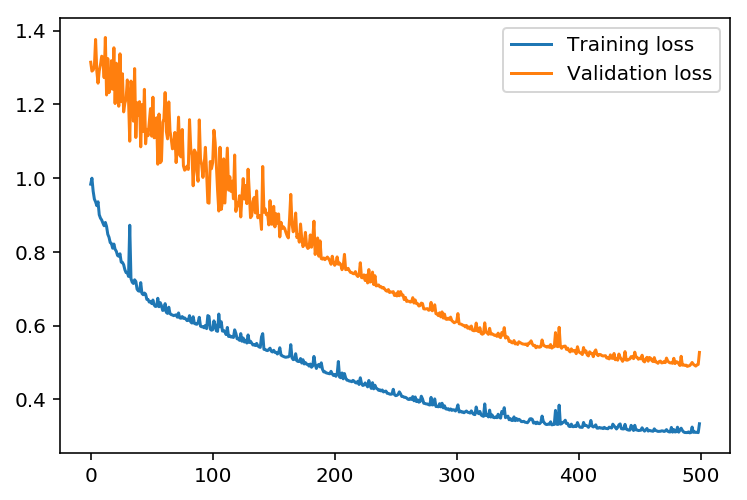

In [13]:
plt.plot(losses['train'], label='Training loss')
plt.plot(losses['validation'], label='Validation loss')
plt.legend()
_ = plt.ylim()

## Check out your predictions

Here, use the test data to view how well your network is modeling the data. If something is completely wrong here, make sure each step in your network is implemented correctly.

/Users/scrier/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:10: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  # Remove the CWD from sys.path while we load stuff.


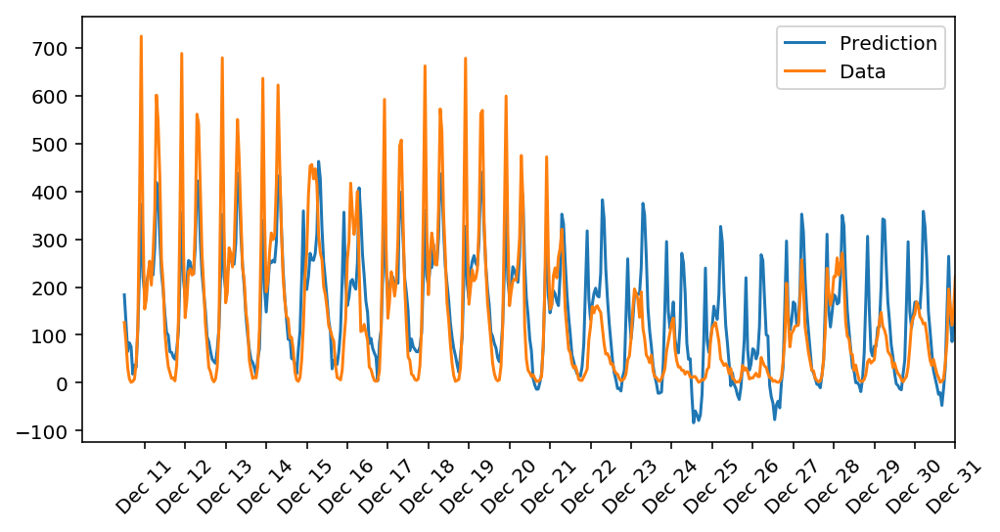

In [14]:
fig, ax = plt.subplots(figsize=(8,4))

mean, std = scaled_features['cnt']
predictions = network.run(test_features).T*std + mean
ax.plot(predictions[0], label='Prediction')
ax.plot((test_targets['cnt']*std + mean).values, label='Data')
ax.set_xlim(right=len(predictions))
ax.legend()

dates = pd.to_datetime(rides.ix[test_data.index]['dteday'])
dates = dates.apply(lambda d: d.strftime('%b %d'))
ax.set_xticks(np.arange(len(dates))[12::24])
_ = ax.set_xticklabels(dates[12::24], rotation=45)

## OPTIONAL: Thinking about your results(this question will not be evaluated in the rubric).
 
Answer these questions about your results. How well does the model predict the data? Where does it fail? Why does it fail where it does?

> **Note:** You can edit the text in this cell by double clicking on it. When you want to render the text, press control + enter

#### Your answer below